In [1]:
import math
import random
from typing import Tuple
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import csv
random.seed(10)

In [2]:
import pickle
from pathlib import Path

# Structure: (theta, phi) -> (theta_etilt, phi_scan)
saved_tp = dict()
saved_tp_file = Path("t4p4.pkl")
if saved_tp_file.is_file():
    with open(saved_tp_file, "rb") as f:
        saved_tp = pickle.load(f)
        
# Structure: (segment, polygon) -> (boolean True or False)
saved_los = dict()

saved_los_file = Path("los4.pkl")
if saved_los_file.is_file():
    with open(saved_los_file, "rb") as f:
        saved_los = pickle.load(f)

In [3]:
!pip install Geometry3D shapely

In [4]:
from Geometry3D import *
from shapely import geometry

In [5]:
data = pd.read_csv("C:\\Users\\tniloy\\Downloads\\opencellid dataset\\310.csv", names=['radio', 'mcc', 'mnc', 'lac', 'cid', 'unit', 'longitude', 'latitude', 'range', 'samples', 'changeable', 'created', 'updated', 'averageSignal'])

In [6]:
data.head (10)

,radio,mcc,mnc,lac,cid,unit,longitude,latitude,range,samples,changeable,created,updated,averageSignal
0,GSM,310,260,32192,22568,0,-73.858566,40.898438,1779,12,1,1459696254,1489125559,0
1,GSM,310,260,22629,61562,0,-95.876501,41.286475,3367,17,1,1459810860,1609205988,0
2,GSM,310,260,51052,44152,0,-71.084483,42.381728,1000,44,1,1459812328,1514115939,0
3,GSM,310,260,51051,40311,0,-71.085559,42.381356,1000,52,1,1459812328,1527695374,0
4,GSM,310,260,5973,60092,0,-95.570630,29.735371,1000,22,1,1459692332,1490851584,0
5,GSM,310,410,19007,7133,0,-87.258205,40.153886,19135,6,1,1459699529,1472415099,0
6,GSM,310,410,53005,50671,0,-95.563889,30.280380,1000,1,1,1459775023,1459775023,0
7,GSM,310,260,46136,15418,0,-76.999741,39.160080,1000,1,1,1459663271,1459663271,0
8,GSM,310,410,27672,59021,0,-81.741964,26.213691,1000,11,1,1459687298,1491031828,0
9,GSM,310,260,5973,50942,0,-95.560226,29.736557,1000,6,1,1459692332,1469493454,0


In [7]:
# center_x = 0
# center_y = 0
# center_z = 0
# FSS POsition:
lat_FSS= 37.20250
lon_FSS= -80.43444
R  = 6.371e6  #Radius of the earth

x_FSS = R * math.cos(math.radians(lat_FSS)) * math.cos(math.radians(lon_FSS))
y_FSS = R * math.cos(math.radians(lat_FSS)) * math.sin(math.radians(lon_FSS))
z_FSS = R * math.sin(math.radians(lat_FSS))

print("X, Y, Z = "+ str([x_FSS, y_FSS, z_FSS]))


radius=5000 #radius of the inclusion zone
latitude_range = radius / 110574
longitude_range = radius/(111320*math.cos(math.radians(latitude_range)))
print("Total area of inclusion zone is = " + str(radius*radius*math.pi))

X, Y, Z = [843264.3231973607, -5003968.368478095, 3852122.3823358943]
Total area of inclusion zone is = 78539816.33974482


In [8]:
print(latitude_range)
print(longitude_range)

0.04521858664785573
0.044915572737550945


In [9]:
data_within_zone = data[(data['radio'] == 'GSM') & (data['longitude'] <= (lon_FSS + longitude_range)) & (data['longitude'] >= (lon_FSS - longitude_range)) & (data['latitude'] <= (lat_FSS + latitude_range)) & (data['latitude'] >= (lat_FSS - latitude_range))]

data_within_zone.head(10)


,radio,mcc,mnc,lac,cid,unit,longitude,latitude,range,samples,changeable,created,updated,averageSignal
780410,GSM,310,260,37630,43582,0,-80.393175,37.196127,8733,3992,1,1413757287,1435049916,0
1813932,GSM,310,260,32453,43561,0,-80.421524,37.189560,1000,9,1,1458834001,1491931840,0
1813934,GSM,310,260,32453,43602,0,-80.410309,37.233810,1000,6,1,1458834001,1479555225,0
1814053,GSM,310,260,32453,43822,0,-80.406704,37.227516,1000,8,1,1458834001,1479576548,0
1814075,GSM,310,260,32453,43583,0,-80.461073,37.203233,2207,15,1,1458834001,1477155991,0
1814213,GSM,310,260,32453,43581,0,-80.409897,37.217972,1000,5,1,1458834001,1473235293,0
1814220,GSM,310,260,32453,43601,0,-80.425186,37.236099,1000,6,1,1458834001,1473191254,0
1814361,GSM,310,260,32453,43562,0,-80.391645,37.165063,1000,11,1,1458834001,1489446412,0
1814366,GSM,310,260,32453,43603,0,-80.425415,37.222710,1000,4,1,1458834001,1474352285,0
1814368,GSM,310,260,32453,43621,0,-80.393486,37.224279,1033,56,1,1458834001,1482422269,0


In [10]:
len(data_within_zone)

33

In [11]:
import json
with open ('C:\\Users\\tniloy\\Downloads\\export (1).geojson') as f:
    df=json.load(f)
    data1=pd.json_normalize(df,record_path=['features'])
data1.head(10)

,type,id,properties.@id,properties.addr:housenumber,properties.addr:street,properties.building,properties.height,properties.name,properties.operator,properties.type,...,properties.automatic_door,properties.access,properties.button_operated,properties.door,properties.operator:short,properties.operator:type,properties.operator:wikidata,properties.operator:wikipedia,properties.foot,properties.vehicle
0,Feature,relation/308029,relation/308029,630,Washington Street Southwest,dormitory,15.7,Pritchard Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Feature,relation/548333,relation/548333,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Feature,relation/548339,relation/548339,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Feature,relation/548344,relation/548344,1406,Giles Road,church,NaN,Blacksburg First Wesleyan Church,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Feature,relation/548347,relation/548347,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,Feature,relation/548348,relation/548348,NaN,NaN,residential,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,Feature,relation/548371,relation/548371,1416,Palmer Drive,detached,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,Feature,relation/548372,relation/548372,900,Dickerson Lane,detached,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,Feature,relation/548373,relation/548373,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,Feature,relation/548386,relation/548386,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [12]:
data1[data1["properties.height"].notnull()].head(20)

,type,id,properties.@id,properties.addr:housenumber,properties.addr:street,properties.building,properties.height,properties.name,properties.operator,properties.type,...,properties.automatic_door,properties.access,properties.button_operated,properties.door,properties.operator:short,properties.operator:type,properties.operator:wikidata,properties.operator:wikipedia,properties.foot,properties.vehicle
0,Feature,relation/308029,relation/308029,630,Washington Street Southwest,dormitory,15.7,Pritchard Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
33,Feature,relation/1360465,relation/1360465,NaN,NaN,university,14.86,East Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
34,Feature,relation/1360466,relation/1360466,NaN,NaN,dormitory,14.86,West Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
35,Feature,relation/1360467,relation/1360467,NaN,NaN,dormitory,11.27,Slusher Wing,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
36,Feature,relation/1360468,relation/1360468,NaN,NaN,dormitory,33.59,Slusher Tower,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
37,Feature,relation/1360469,relation/1360469,NaN,NaN,dormitory,14.86,Main Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
66,Feature,way/26210227,way/26210227,NaN,NaN,university,15.47,Cheatham Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
67,Feature,way/26210236,way/26210236,285,Ag Quad Lane,university,11.57,Dietrick Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
69,Feature,way/32709325,way/32709325,570,Washington Street Southwest,dormitory,25.82,Hoge Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
98,Feature,way/32953606,way/32953606,210,Drillfield Drive,university,11.61,Sandy Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [13]:
data1["geometry.coordinates"].head(10)

0    [[[-80.4194702, 37.2238774], [-80.4194505, 37....
1    [[[-80.4070717, 37.2320238], [-80.4069865, 37....
2    [[[-80.4068521, 37.2319488], [-80.4069373, 37....
3    [[[-80.4104274, 37.2506844], [-80.4104412, 37....
4    [[[-80.4355296, 37.2138316], [-80.4355103, 37....
5    [[[-80.4416012, 37.2238365], [-80.4417281, 37....
6    [[[-80.3924701, 37.2185727], [-80.3923812, 37....
7    [[[-80.4121293, 37.2397986], [-80.4121648, 37....
8    [[[-80.4075916, 37.2253453], [-80.4076676, 37....
9    [[[-80.4071473, 37.2322051], [-80.4072218, 37....
Name: geometry.coordinates, dtype: object

In [14]:
class Building:
    def __init__(self, coordinates=None, height=None):
        self.coordinates = []
        if coordinates is not None:
            self.coordinates = coordinates
        
        if height is None or not str(height).isdigit():
            self.height = random.uniform(10, 40)
        else:
            self.height = height
        
        self.x_coord, self.y_coord, self.z_coord = self.latlon_to_XYZ()
        
        self.points = []
        for i in range(len(self.x_coord)):
            x, y, z = self.x_coord[i], self.y_coord[i], self.z_coord[i]
            self.points.append(Point(x,y,z))
        
        self.xy_points = np.array([(p.x, p.y) for p in self.points])
        self.xy_polygon = geometry.Polygon(self.xy_points)
        
        self.wall_polygons = self.get_wall_polygons()
    
    def latlon_to_XYZ(self):
        x_coord = np.array([])
        y_coord = np.array([])
        z_coord = np.array([])
        
        # bottom points of building at each coordinate
        for lon, lat in self.coordinates:
            x = R * math.cos(math.radians(lat)) * math.cos(math.radians(lon))
            y = R * math.cos(math.radians(lat)) * math.sin(math.radians(lon))
            x_coord = np.append(x_coord, x)
            y_coord = np.append(y_coord, y)
            z_coord = np.append(z_coord, 0)
            # z_coord = np.append(z_coord, self.height)
            
        # make coordinates to relative to FSS position
        x_coord -= x_FSS
        y_coord -= y_FSS
        
        return x_coord, y_coord, z_coord

    def get_wall_polygons(self):
        polygons = []

        # points = [Point(x,y,0) for x,y in p.boundary.coords]
        # polygons.append(ConvexPolygon(points))
        points = [Point(x,y,self.height) for x,y in self.xy_polygon.boundary.coords]
        # polygons.append(ConvexPolygon(points))

        for i in range(len(points)-1):
            high_point_1 = points[i]
            high_point_2 = points[i + 1]
            low_point_1 = Point(high_point_1.x, high_point_1.y, 0)
            low_point_2 = Point(high_point_2.x, high_point_2.y, 0)

            poly_points = [low_point_1, low_point_2, high_point_1, high_point_2]
            #print(poly_points)
            polygons.append(ConvexPolygon(poly_points))
            
        return polygons
        

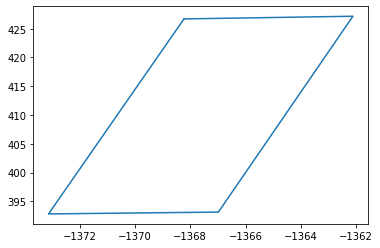

In [15]:
from shapely import geometry

b = Building(data1.iloc[500]["geometry.coordinates"][0], data1.iloc[500]["properties.height"])
x, y = b.xy_polygon.boundary.xy
plt.plot(x, y)

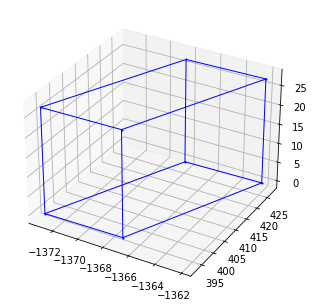

In [16]:
r = Renderer(backend='matplotlib')
for p in b.wall_polygons:
    r.add((p,'b',1),normal_length=0)
r.show()

In [17]:
from tqdm import tqdm
buildings = []

for i in tqdm(range(len(data1))):
    for coords in data1.iloc[i]["geometry.coordinates"]:
        try:
            buildings.append(Building(coords, data1.iloc[i]["properties.height"]))
        except:
            print(f"Skipping building {i}")

  1%|▌                                                                              | 68/8644 [00:00<00:40, 214.01it/s]

Skipping building 26
Skipping building 26
Skipping building 27
Skipping building 27
Skipping building 27
Skipping building 28
Skipping building 28
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 53
Skipping building 53
Skipping building 53
Skipping building 53


100%|█████████████████████████████████████████████████████████████████████████████| 8644/8644 [00:16<00:00, 525.18it/s]

Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8170
Skipping building 8170
Skipping building 8170
Skipping bu

In [18]:
class FSS_Channels:
  # channels start at 0, so a channel plan with 8 channels is from 0 to 7

  band_width = 240e6 # 240MHz

  # 10.7-12.7 GHz frequency range
  range_start = 10.7e9 # 10.7GHz
  range_end = 12.7e9 # 12.7GHz

  channel_count = 8

  range_size = range_end - range_start
  unused_space = range_size - band_width * channel_count

  # FSS channel spacing should be 10MHz
  space_between_channels = unused_space / channel_count

  @staticmethod
  def getChannelRange(channel) -> Tuple[int, int]:
    channel_start = int((0.5 + channel) * FSS_Channels.space_between_channels + channel * FSS_Channels.band_width)
    channel_end = channel_start + FSS_Channels.band_width
    return channel_start, channel_end

  def __init__(channel):
    self.channel = channel

In [19]:
class BS_Channels:
  # channels start at 1, so a channel plan with 5 channels is from 1 to 5

  band_width = 100e6 # 100MHz

  # 12.2-12.7 GHz frequency range
  range_start = 12.2e9 # 12.2GHz
  range_end = 12.7e9 # 12.7GHz

  channel_count = 5

  range_size = range_end - range_start
  unused_space = range_size - band_width * channel_count

  # BS channel spacing should be 0MHz
  space_between_channels = unused_space / channel_count

  @staticmethod
  def getChannelRange(channel) -> Tuple[int, int]:
    channel -= 1
    
    channel_start = int((0.5 + channel) * BS_Channels.space_between_channels + channel * BS_Channels.band_width)
    channel_end = channel_start + BS_Channels.band_width
    return channel_start, channel_end

  def __init__(channel):
    self.channel = channel

In [20]:
def path_loss_UMi(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##UMi
##LOS,SF=4:

##(10m<=d_2D)<=D_BP:
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+((FSS_Y-BS_Y)**2)+((4.5-10)**2))
    hBs=10
    fc=12
    d_3D=math.sqrt(hBs**2+d_2D**2)
    PL1umi=32.4+21*math.log10(d_3D)+20*math.log10(fc)
    
##(D_BP<=d_2D)<=5000m:
    hBs=10
    hUT=4.5
    hE=1
    hBs1=hBs-hE
    hUT1=hUT-hE
    c=3e8
    D_BP= (4*hBs1*hUT1*12e9)/c
    PL2umi=32.4+40*math.log10(d_3D)+20*math.log10(fc)-9.5*math.log10((D_BP)**2+(hBs-hUT)**2)
    
    if 10 <=d_2D and d_2D<=D_BP:
        PLUMiLOS=PL1umi
    elif D_BP<=d_2D and  d_2D<=5000:
        PLUMiLOS= PL2umi  
    else:
        PLUMiLOS=1

##NLOS,SF=7.82:
    PL1umiNLOS= 35.3*math.log10(d_3D)+22.4+21.3*math.log10(fc)-0.3*(hUT-1.5)
    PLUMiNLOS= max(PLUMiLOS,PL1umiNLOS)
    
    line_of_sight = True
    
##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, 10), Point(FSS_X, FSS_Y, 4.5))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_UMi = PLUMiNLOS
                    line_of_sight = False
                else:
                    path_loss_UMi = PLUMiLOS
#                     line_of_sight = True
    
 # intersection(line, polygon): [Intersection], None
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_UMi = PLUMiNLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_UMi = PLUMiLOS
#                 line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False
    
# #Loss Probability:
#     if d_2D>18:
#         PrLosUmi=(18/d_2D)+math.exp((-(d_2D/36))*(1-(18/d_2D)))     
#     else:
#         PrLosUmi=1 ##d_2d<=18     
#     if PrLosUmi > random.random():
#         path_loss_UMi = PLUMiLOS   
#     else:
#         path_loss_UMi = PLUMiNLOS   
##path_loss 
#     path_loss_UMi= PL2umi*PrLosUmi+PL1umiNLOS*(1-PrLosUmi)
    
    return path_loss_UMi, d_2D, line_of_sight

In [21]:
def path_loss_UMa(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##LOS,SF=4:
##(10m<=d_2D)<=D_BP:
    fc=12
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+(FSS_Y- BS_Y)**2)+((FSS_Z-BS_Z)**2)
    hBs=25
    d_3D=math.sqrt(hBs**2+d_2D**2)
    PL3uma=28.0+22*math.log10(d_3D)+20*math.log10(fc)
    
##(D_BP<=d_2D) <=5000m:
    hUT=1.5
    hE=1
    hBs1=hBs-hE
    hUT1=hUT-hE
    c=3e8
    D_BP= (4*hBs1*hUT1*12e9)/c
    PL4uma=28.0+40*math.log10(d_3D)+20*math.log10(fc)-9*math.log10((D_BP)**2+(hBs-hUT)**2)
    
    if 10 <=d_2D and d_2D<=D_BP:
        PLUMALOS=PL3uma
    elif D_BP<=d_2D and d_2D<=5000:
         PLUMALOS= PL4uma  
    else:
        PLUMALOS=1
        
##NLOS,SF=6:
    PL1NLOSuma=13.54+39.08*math.log10(d_3D)+20*math.log10(fc)-0.6*(hUT-1.5)
    PLUMANLOS=max(PLUMALOS,PL1NLOSuma)
    
    line_of_sight = True

##NLOS,SF=7.8 (optional)
##PL_Optional=32.4+20*math.log(fc)+30*math.log(d_3D)


##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, BS_Z), Point(FSS_X, FSS_Y, FSS_Z))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_UMa = PLUMANLOS
                    line_of_sight = False
                else:
                    path_loss_UMa = PLUMALOS
#                     line_of_sight = True
                
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_UMa = PLUMANLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_UMa = PLUMALOS
#                 line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False


##Loss Probability:
#     if d_2D >18:
#         if hUT<=13:
#             ChUT=0
#         elif 13<hUT and hUT<=23:
#             ChUT=((hUT-13)/10)**1.5  
#         PrLOSUma=((18/d_2D)+math.exp((-(d_2D/63))*(1-(18/d_2D))))*(1+ChUT*(5/4)*((d_2D/100)**3)*math.exp(-(d_2D/150)))
#     else:##18m<d_2D:
#         PrLOSUma=1
        
#     if PrLOSUma > random.random():
#         path_loss_UMa = PLUMALOS
    
#     else:
#         path_loss_UMa = PLUMANLOS
    
##Path Loss
#     path_loss_UMa= PL4uma*PrLOSUma+PL1NLOSuma*(1-PrLOSUma)
    return path_loss_UMa, d_2D, line_of_sight

In [22]:
def path_loss_RMa(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##LOS,SF=4(PL1),SF=6(PL2)
##10m<=d_2D<=d_BP: 
    fc=12
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+((FSS_Y- BS_Y)**2)+((FSS_Z-BS_Z)**2))
    hBs=35
    d_3D= math.sqrt(hBs**2+d_2D**2)
    PL1rma=20*math.log10((40*math.pi*d_3D*fc)/3)+ min(0.03*h**1.72,10)*math.log10(d_3D)-min(0.044*h**1.72,14.77)+0.002*math.log10(h)*d_3D
    
##d_BP<=d_2D<=10km:
    hUT=1.5
    c=3e8
    d_BP= (2*math.pi*hBs*hUT*12e9)/c
    PL2rma= PL1rma*(d_BP)+40*math.log10(d_3D/d_BP)

    if 10<=d_2D and d_2D <=d_BP:
        PLRMALOS=PL1rma
    elif d_BP<=d_2D and d_2D <=10000:
        PLRMALOS= PL2rma  
    else:
        PLRMALOS=1

##NLOS,SF=8:
    W=20
    h=5
    PL1NLOSrma= 161.04-7.11*math.log10(W)+7.5*math.log10(h)-(24.37-3.7*(h/hBs)**2)*math.log10(hBs)+(43.42-3.1*math.log10(hBs))*(math.log10(d_3D)-3)+20*math.log10(fc)-(3.2*(math.log10(11.75*hUT))**2-4.97)
    PLRMANLOS=max(PLRMALOS,PL1NLOSrma)
    
    line_of_sight = True
    
##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, BS_Z), Point(FSS_X, FSS_Y, FSS_Z))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_RMa = PLRMANLOS
                    line_of_sight = False
                else:
                    path_loss_RMa = PLRMALOS
                    # line_of_sight = True
   
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_RMa = PLRMANLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_RMa = PLRMALOS
                # line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False
                
    

# ##Loss Probability:
#     if d_2D>10:
#         PrLOSrma=math.exp(-((d_2D-10)/1000))
        
# ## 10m<d_2D:
#     else:
#         PrLOSrma=1
        
#     if PrLOSrma > random.random():
#         path_loss_RMa= PLRMALOS
    
#     else:
#         path_loss_RMa = PLRMANLOS

##PathLoss:
#     path_loss_RMa=PL2rma*PrLOSrma+PL1NLOSrma*(1-PrLOSrma)
    return path_loss_RMa, d_2D,  line_of_sight

In [23]:
def Interface_UMi_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_UMi,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        # theta_tilt, phi_scan = max_gain_5g_parameters(theta, phi)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, (10-4.5)

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
#         print("Angle between interference axis and FSS main lobe:", fss_phi_difference)
        if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)

#         G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)

        TXPower= 8
#         LBuildingLoss=1
        interface1=TXPower+ 0-pathloss_UMi- LBodyLoss + G_Rx_5G 
        return interface1,pathloss_UMi

In [24]:
def Interface_UMa_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_UMa,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, BS_Z-FSS_Z

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
        if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)

#         G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)
        
        TXPower= 8
#         LBuildingLoss=1
        interface2=TXPower+ 0-pathloss_UMa- LBodyLoss + G_Rx_5G
        return interface2,pathloss_UMa
    

In [25]:
def Interface_RMa_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_RMa,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, BS_Z-FSS_Z

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        # if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
        if output: print("fss_phi_difference:", fss_phi_difference)

#         G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)
        
        TXPower= 8
#         LBuildingLoss=1
        interface3=TXPower+ 0-pathloss_RMa-LBodyLoss + G_Rx_5G
        return interface3,pathloss_RMa

In [26]:
k = 1.38064852*10**(-23)
T=200
B=240e6
Noise = 10*math.log10(k*T*B)
Noise_W = 10 ** (Noise / 10)
print('Noise:', Noise)
print('Noise in Watts:', Noise_W)

Noise: -121.78675630934148
Noise in Watts: 6.627112895999999e-13


In [27]:
bs_ue_max_radius = 1000
bs_ue_min_radius= 1
base_station_count=33

# fss1 = BS(radius, max_height=1.5, carr_freq=12e9, interference_type=None)
x,y,z = 0,0,4.5

FSS_phi = {
    'UMi': 15,
    'UMa': 48,
    'RMa': 5
}

exclusion_zones = [500, 1000, 2000, 3000, 4000]
        
def simulate(output=True):
    FSS_X=np.array([])
    FSS_Y=np.array([])
    FSS_Z=np.array([])
    FSS_CHANNELS = []
    for i in range (1):
        FSS_X = np.append(FSS_X, x)
        FSS_Y = np.append(FSS_Y, y)
        FSS_Z = np.append(FSS_Z, 4.5)
        # 0 means not in use, 1 means in use
        channel_status = [random.randint(0, 1) for i in range(FSS_Channels.channel_count)]
        channels_used = np.array([i for i in range(FSS_Channels.channel_count) if channel_status[i] == 1])
        FSS_CHANNELS.append(channels_used)
        if output: print("FSS Co-ordinates=" +str (x)+ "," + str(y)+ "," + str(z) + ", channel: " + str(channels_used))
    if output: print(FSS_X, FSS_Y, FSS_Z, FSS_CHANNELS)

    # Create base stations
    BS_X=np.array([])
    BS_Y=np.array([])
    BS_Z=np.array([])
    
    # Randomly select base stations 
    # base_station_indexes = random.sample(range(len(data_within_zone)), base_station_count)

    # for i in base_station_indexes:
    for i in range(base_station_count):
        lat_BS, lon_BS = data_within_zone.iloc[i]['latitude'], data_within_zone.iloc[i]['longitude']
#         bs1 = BS(radius, max_height=35, carr_freq=12e9, interference_type=None)
        x_BS = R * math.cos(math.radians(lat_BS)) * math.cos(math.radians(lon_BS))
        y_BS = R * math.cos(math.radians(lat_BS)) * math.sin(math.radians(lon_BS))
#         z_BS = R * math.sin(math.radians(lat_BS))

        BS_X = np.append(BS_X, x_BS - x_FSS)
        BS_Y = np.append(BS_Y, y_BS - y_FSS)
        BS_Z = np.append(BS_Z, 0)
        if output: print("Bs Co-ordinates=" +str (x_BS)+ "," + str(y_BS)+ "," + str(z_BS))
    
    if output: print(BS_X,BS_Y,BS_Z)

    # Create user equipment
    UE_X=np.array([])
    UE_Y=np.array([])
    UE_Z=np.array([])
    UE_CHANNEL=np.array([])
    for p in range (len(BS_X)):
        for i in range(3):
    # number of split regions
    # i is the sector number
            for j in range(10):
      # number of UEs per region
      # j is the number of the UE in one sector
                bs_x, bs_y, bs_z = BS_X[p], BS_Y[p],BS_Z[p]
                theta_bs_ue = random.uniform(120 * i, 120 * (i+1))
                # 0-120, 120-240, 240-360
                radius_bs_ue = random.uniform(bs_ue_min_radius, bs_ue_max_radius)

                x1 = bs_x + radius_bs_ue * math.cos(math.radians(theta_bs_ue))
                y1 = bs_y + radius_bs_ue * math.sin(math.radians(theta_bs_ue))

                UE_X = np.append(UE_X, x1)
                UE_Y = np.append(UE_Y, y1)
                UE_Z = np.append(UE_Z, 1.5)

                maximum_UEs_per_channel = 4

                if j > maximum_UEs_per_channel * BS_Channels.channel_count:
                    raise Exception(f"BS cannot support {j} UEs")

                count = {i: 0 for i in range(1, BS_Channels.channel_count + 1)}

                channel = random.randint(1, BS_Channels.channel_count)

                while count[channel] >= maximum_UEs_per_channel:
                    channel = random.randint(1, BS_Channels.channel_count)

                count[channel] += 1

                UE_CHANNEL = np.append(UE_CHANNEL, channel)

                if output: print("UE Co-ordinates=" +str (x1)+ "," + str(y1)+ "," + str(z1) + ", channel: " + str(channel))
            if output: print(UE_X,UE_Y,UE_Z)
        
    pathloss_UMa=np.empty([0])
    pathloss_UMi=np.empty([0])
    pathloss_RMa=np.empty([0])
    distance_UMa=np.empty([0])
    distance_UMi=np.empty([0])
    distance_RMa=np.empty([0])
    line_of_sight=np.empty([0])
    for i in range(len(BS_X)):
        for j in range (len(FSS_X)):
            pathlossumi,distance,los_single = path_loss_UMi(BS_X[i],BS_Y[i],10,FSS_X[j],FSS_Y[j],4.5)
            pathlossuma,distance,los_single = path_loss_UMa(BS_X[i],BS_Y[i],25,FSS_X[j],FSS_Y[j],FSS_Z[j])
            pathlossrma,distance,los_single = path_loss_RMa(BS_X[i],BS_Y[i],35,FSS_X[j],FSS_Y[j],FSS_Z[j])
            if output: print("pathloss umi:", pathlossumi, "uma:", pathlossuma, "rma:", pathlossrma, "for distance", distance)
            
            pathloss_UMa=np.append(pathloss_UMa,pathlossuma)
            distance_UMa=np.append(distance_UMa,distance)
            pathloss_UMi=np.append(pathloss_UMi,pathlossumi)
            distance_UMi=np.append(distance_UMi,distance)
            pathloss_RMa=np.append(pathloss_RMa,pathlossrma)
            distance_RMa=np.append(distance_RMa,distance)
            
            line_of_sight=np.append(line_of_sight,los_single)
            

    if output: print(pathloss_UMi,distance_UMi)
    if output: print(pathloss_UMa,distance_UMa)
    if output: print(pathloss_RMa,distance_RMa)

    interface_UMi_W = {exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones}
    interface_UMa_W = {exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones}
    interface_RMa_W = {exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones}
    for i in range(len(BS_X)):
        interface_UMi_BS=np.empty([0])
        interface_UMa_BS=np.empty([0])
        interface_RMa_BS=np.empty([0])
        for j in range(len(FSS_X)):
            print(f"BS {i}, FSS {j}, pathloss {pathloss_UMi[i*len(FSS_X)+j]}")
            for k in random.sample(range(len(UE_X)),30):
                # channel check
                # if UE is using channel 1, the start is 12.2GHz and the end is 12.3GHz
                bs_channel_start, bs_channel_end = BS_Channels.getChannelRange(UE_CHANNEL[k])
                bs_channel_range = range(bs_channel_start, int(bs_channel_end + (5e6)), int(5e6))

                interference_found = False

                for fss_channel in FSS_CHANNELS[j]:
                    # if fss_channel >= 6:
                    fss_channel_start, fss_channel_end = FSS_Channels.getChannelRange(fss_channel)
                    fss_channel_range = range(bs_channel_start, int(bs_channel_end + (5e6)), int(5e6))
                    
                    bs_set = set(bs_channel_range)
                    if len(bs_set.intersection(fss_channel_range)):
                        interference_found = True

                if not interference_found:
#                     interface_UMi_W=np.append(interface_UMi_W,0)
#                     interface_UMa_W=np.append(interface_UMa_W,0)
#                     interface_RMa_W=np.append(interface_RMa_W,0)
                    continue

                for interference_type in ["UMi", "UMa", "RMa"]:
                    if interference_type == "UMi":
                        BS_Z = np.array([10 for i in range(len(BS_X))])
                    elif interference_type == "UMa":
                        BS_Z = np.array([25 for i in range(len(BS_X))])
                    elif interference_type == "RMa":
                        BS_Z = np.array([35 for i in range(len(BS_X))])
                    # bs_ue_x, bs_ue_y, bs_ue_z = BS_X-UE_X, BS_Y-UE_Y, BS_Z-UE_Z
                    bs_ue_x, bs_ue_y, bs_ue_z = UE_X[k]-BS_X[i], UE_Y[k]-BS_Y[i], UE_Z[k]-BS_Z[i]

                    theta_bs_ue = np.arctan(bs_ue_y/bs_ue_x)
                    phi_bs_ue = np.sqrt(bs_ue_x**2 + bs_ue_y**2) / bs_ue_z

                    theta_bs_ue = np.degrees(theta_bs_ue) % 360
                    phi_bs_ue = np.degrees(phi_bs_ue) % 360
                    if output: print("theta_bs_ue:", theta_bs_ue, "phi_bs_ue:", phi_bs_ue)

#                     theta_tilt, phi_scan = max_gain_5g_parameters(theta_bs_ue, phi_bs_ue)
                    

                    if interference_type == "UMi":
                        interfaceumi,pathloss_UMi_x= Interface_UMi_1(BS_X[i],BS_Y[i],10,FSS_X[j],FSS_Y[j],4.5,FSS_phi['UMi'],pathloss_UMi[i*len(FSS_X)+j])
                        print("UE:", k, "/ interference umi:", interfaceumi, "/ pathloss:", pathlossumi)
                        interface_UMi_BS=np.append(interface_UMi_BS,interfaceumi)
#                     elif interference_type == "UMa":
#                         interfaceuma,pathloss_UMa_x= Interface_UMa_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['UMa'],pathloss_UMa[i*len(FSS_X)+j],theta_tilt,phi_scan)
#                         print("UE:", k, "/ interference uma:", interfaceuma, "/ pathloss:", pathlossuma)
#                         interface_UMa_BS=np.append(interface_UMa_BS,interfaceuma)
#                     elif interference_type == "RMa":
#                         interfacerma,pathloss_RMa_x= Interface_RMa_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['RMa'],pathloss_RMa[i*len(FSS_X)+j],theta_tilt,phi_scan)
#                         print("UE:", k, "/ interference rma:", interfacerma, "/ pathloss:", pathlossrma)
#                         interface_RMa_BS=np.append(interface_RMa_BS,interfacerma)
        
        for exclusion_zone in exclusion_zones:
            if distance_UMi[i*len(FSS_X)+j] > exclusion_zone:
                interface_UMi_W[exclusion_zone] = np.append(interface_UMi_W[exclusion_zone], np.sum(10 ** (interface_UMi_BS / 10))/30)
            if distance_UMa[i*len(FSS_X)+j] > exclusion_zone:
                interface_UMa_W[exclusion_zone] = np.append(interface_UMa_W[exclusion_zone], np.sum(10 ** (interface_UMa_BS / 10))/30)
            if distance_RMa[i*len(FSS_X)+j] > exclusion_zone:
                interface_RMa_W[exclusion_zone] = np.append(interface_RMa_W[exclusion_zone], np.sum(10 ** (interface_RMa_BS / 10))/30)
              
    if output: print(interface_UMi_W,pathloss_UMi)
    if output: print(interface_UMa_W,pathloss_UMa)
    if output: print(interface_RMa_W,pathloss_RMa)

    # I_N_UMi = np.array([interfaceumi-Noise for interfaceumi in interface_UMi])
    I_N_UMi, I_N_UMa, I_N_RMa = dict(), dict(), dict()
    for exclusion_zone in exclusion_zones:
        I_N_UMi[exclusion_zone] = interface_UMi_W[exclusion_zone] / Noise_W
    if output: print('I/N UMi:', I_N_UMi) 
    for exclusion_zone in exclusion_zones:
        I_N_UMa[exclusion_zone] = interface_UMa_W[exclusion_zone] / Noise_W  
    if output: print('I/N UMa:', I_N_UMa)
    for exclusion_zone in exclusion_zones:
        I_N_RMa[exclusion_zone] = interface_RMa_W[exclusion_zone] / Noise_W
    if output: print('I/N RMa:', I_N_RMa)  

    return distance_RMa, I_N_RMa, distance_UMa, I_N_UMa, distance_UMi, I_N_UMi, line_of_sight
        

In [28]:
# Prototype functions to calculate antenna gain of 5G base station and FSS earth station

import math, cmath
from scipy import optimize

# gain is in dBi

# 3GPP TR 38.901
# https://www.etsi.org/deliver/etsi_tr/138900_138999/138901/14.00.00_60/tr_138901v140000p.pdf
antenna_gain_max = 8

# values recommended by Dr. Zoheb
rows = 16  # Nv
cols = 16  # Nh
hspace = 0.5  # dh/λ
vspace = 0.5  # dv/λ

# constant values based on ECC Rep 281
phi_3db = 80  # degrees
theta_3db = 65  # degrees
front_to_back_ratio = 30  # dB
side_lobe_level_limit = 30  # dB

# antenna horizontal pattern
def gain_antenna_element_horizontal(phi) -> float:
    return -min(
                12 * (phi / phi_3db)**2, 
                front_to_back_ratio
            )

# antenna vertical pattern
def gain_antenna_element_vertical(theta) -> float:
    return -min(
                12 * ((theta - 90) / theta_3db)**2,
                side_lobe_level_limit
            )

# antenna element gain of elevation and azimuth plane
def gain_antenna_element(theta, phi) -> float:
    return antenna_gain_max - \
            min(
                -(gain_antenna_element_horizontal(phi) + gain_antenna_element_vertical(theta)), 
                front_to_back_ratio
            )

def superposition(n, m, theta, phi, hspace, vspace) -> complex:
    return cmath.exp(complex(0, 2 * math.pi * \
                (
                    (n-1) * vspace * math.cos(math.radians(theta)) + \
                    (m-1) * hspace * math.sin(math.radians(theta)) * math.sin(math.radians(phi))
                )
            ))

def weighting(n, m, theta_tilt, phi_scan, hspace, vspace) -> complex:
    return cmath.exp(complex(0, -2 * math.pi * \
                (
                    (n-1) * vspace * math.sin(math.radians(theta_tilt)) + \
                    (m-1) * hspace * math.cos(math.radians(theta_tilt)) * math.sin(math.radians(phi_scan))
                )
            )) / cmath.sqrt(rows * cols)

# returns theta_tilt and phi_scan which yield maximum antenna gain given theta and phi
# def max_gain_5g_parameters(theta, phi, coarse=True, rounding_precision=0) -> tuple:
#     if coarse:
#         theta = round(theta, rounding_precision)
#         phi = round(phi, rounding_precision)
#     if (theta, phi) in saved_tp:
#         # print(f'match found for ({theta}, {phi}), using that')
#         return saved_tp.get((theta, phi))
    
    
    
#     # return max_parameters
#     # scipy's optimization can only find the minimum, so we pass a function which returns the negative of the weighting function
#     result = optimize.brute(
#         lambda x: -beam_pattern_5g(theta, phi, x[0], x[1]),  # x[0] = theta_tilt, x[1] = phi_scan
#         # theta_tilt is between -90 and 90 degrees, phi_scan is between -180 and 180 degrees
#         ranges = [(-90, 90), (-180, 180)]
        
#     )
#     saved_tp[(theta, phi)] = tuple(x for x in result)
    
#     return saved_tp[(theta, phi)]


# a_A, the directional pattern from beam forming with an array of elements
# def beam_pattern_5g(theta, phi, theta_tilt, phi_scan) -> float:
#     summation = 0
#     # weighting multiplied by the superposition vector
#     for n in range(1, rows+1):
#         for m in range(1, cols+1):
#             # print(f"{theta_tilt}, {phi_scan}, {abs(weighting(n, m, theta_tilt, phi_scan, hspace, vspace))}")
#             summation += weighting(n, m, theta_tilt, phi_scan, hspace, vspace) * superposition(n, m, theta, phi, hspace, vspace)

#     return abs(summation)**2

# # antenna gain of 5G base station (represented by a single beam i)
# # def gain_5g(theta, phi, theta_tilt, phi_scan) -> float:
# #     beam_pattern = beam_pattern_5g(theta, phi, theta_tilt, phi_scan)

# #     return gain_antenna_element(theta, phi) + \
# #            10 * math.log10(beam_pattern)

# # space refers to D/λ
# def get_phi_min(space) -> float:
#     # Rec. ITU-R S.465-6
#     if space >= 50:
#         return max(1.0, 100 * (1 / space))
#     else:
#         return max(2.0, 114 * (space ** -1.09))

# receiving antenna gain of FSS earth station
# phi is an angle between base station antenna direction and FSS ES antenna's main axis (elevation angle)
# def gain_fss_s1428(phi, phi_min) -> float:

#     if 0 < phi < phi_min:
#         return 32 - 25 * math.log10(phi_min)
#     elif phi_min <= phi < 48:
#         return 32 - 25 * math.log10(phi)
#     elif 48 <= phi <= 180:
#         return -10

#     # This function is only defined where phi is within (0, 180]
#     raise ValueError(f'Angle phi must be within the interval (0, 180] degrees, was {phi} degrees instead')

# co-polarized components only
# https://www.etsi.org/deliver/etsi_en/303900_303999/303981/01.02.01_60/en_303981v010201p.pdf
def gain_fss_wbes_b(phi) -> float:
    if 0 <= phi < 6:
        return 20
    elif 6 <= phi < 48:
        return 40 - 25 * math.log10(phi)
    elif 48 <= phi <= 180:
        return -2
    elif 180 <= phi <= 360:
        return gain_fss_wbes_b(360 - phi)

    # This function is only defined where phi is within [6, 180]
    raise ValueError(f'Angle phi must be within the interval [6, 180] degrees, was {phi} degrees instead')
    

In [29]:
from tqdm import tqdm
distance_RMa, distance_UMa, distance_UMi, line_of_sight = [np.empty([0]) for x in range(4)]
I_N_RMa_W, I_N_RMa_noAverage, I_N_UMa_W, I_N_UMa_noAverage, I_N_UMi_W, I_N_UMi_noAverage = [{exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones} for x in range(6)]

simulation_count = 10
for i in tqdm(range(simulation_count)):
    distance_RMa_single, I_N_RMa_single_W, distance_UMa_single, I_N_UMa_single_W, distance_UMi_single, I_N_UMi_single_W, line_of_sight_single = simulate(output=False)
    distance_RMa = np.append(distance_RMa, distance_RMa_single)
    distance_UMa = np.append(distance_UMa, distance_UMa_single)
    distance_UMi = np.append(distance_UMi, distance_UMi_single)

    I_N_groups = [
      (I_N_RMa_W, I_N_RMa_noAverage, I_N_RMa_single_W),
      (I_N_UMa_W, I_N_UMa_noAverage, I_N_UMa_single_W),
      (I_N_UMi_W, I_N_UMi_noAverage, I_N_UMi_single_W)
   ]
    for I_N_W, I_N_noAverage, I_N_single_W in I_N_groups:
        for exclusion_zone in exclusion_zones:
            I_N_W[exclusion_zone] = np.append(I_N_W[exclusion_zone], I_N_single_W[exclusion_zone])
            I_N_noAverage[exclusion_zone] = np.append(I_N_noAverage[exclusion_zone], 10 * np.log10(I_N_single_W[exclusion_zone]))
    
    line_of_sight = np.append(line_of_sight, line_of_sight_single)
    
for arr in (I_N_RMa_noAverage,I_N_UMa_noAverage,I_N_UMi_noAverage):
    arr[arr == -np.inf]=0

# for arr in (I_N_RMa_noAverage,I_N_UMa_noAverage,I_N_UMi_noAverage):
#     for exclusion_zone in exclusion_zones:
#         arr[exclusion_zone][arr[exclusion_zone] == -np.inf]=0
    
I_N_RMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_RMa_W[exclusion_zone])) for exclusion_zone in I_N_RMa_W}
I_N_UMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_UMa_W[exclusion_zone])) for exclusion_zone in I_N_UMa_W}
I_N_UMi = {exclusion_zone: 10 * np.log10(np.sum(I_N_UMi_W[exclusion_zone])) for exclusion_zone in I_N_UMi_W}

pairs = {
  'RMa': (np.average(distance_RMa), I_N_RMa),
  'UMa': (np.average(distance_UMa), I_N_UMa),
  'UMi': (np.average(distance_UMi), I_N_UMi)
}

pairs_noAverage = {
  'RMa': (distance_RMa, I_N_RMa_noAverage),
  'UMa': (distance_UMa, I_N_UMa_noAverage),
  'UMi': (distance_UMi, I_N_UMi_noAverage)
}


 41%|███████████████████████████████▏                                             | 3313/8177 [00:07<00:12, 390.02it/s]


 87%|███████████████████████████████████████████████████████████████████          | 7127/8177 [00:14<00:02, 411.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.99it/s]

 30%|███████████████████████▎                                                     | 2472/8177 [00:05<00:13, 427.31it/s]


 75%|█████████████████████████████████████████████████████████▍                   | 6097/8177 [00:12<00:03, 561.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.02it/s]

 18%|█████████████▋                                                               | 1447/8177 [00:03<00:11, 566.35it/s]


 62%|███████████████████████████████████████████████▉                             | 5089/8177 [00:10<00:05, 527.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.29it/s]

  5%|████                                                                          | 421/8177 [00:01<00:20, 377.98it/s]


 51%|██████████████████████████████████████▉                                      | 4131/8177 [00:08<00:07, 545.67it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7881/8177 [00:16<00:00, 449.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 485.44it/s]

 39%|█████████████████████████████▊                                               | 3163/8177 [00:07<00:13, 375.36it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6931/8177 [00:14<00:02, 534.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 484.43it/s]

 27%|████████████████████▋                                                        | 2203/8177 [00:04<00:14, 406.55it/s]


 72%|███████████████████████████████████████████████████████▊                     | 5925/8177 [00:12<00:04, 511.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 483.37it/s]

 15%|███████████▏                                                                 | 1188/8177 [00:03<00:15, 447.25it/s]


 59%|█████████████████████████████████████████████▎                               | 4816/8177 [00:10<00:06, 499.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 466.22it/s]

  2%|█▎                                                                            | 137/8177 [00:00<00:34, 232.21it/s]


 44%|█████████████████████████████████▉                                           | 3605/8177 [00:08<00:08, 547.04it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7222/8177 [00:15<00:01, 481.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 465.78it/s]

 30%|███████████████████████▏                                                     | 2466/8177 [00:05<00:14, 403.41it/s]


 73%|████████████████████████████████████████████████████████▌                    | 6003/8177 [00:13<00:04, 519.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 464.32it/s]

 15%|███████████▏                                                                 | 1187/8177 [00:03<00:15, 446.27it/s]


 59%|█████████████████████████████████████████████▎                               | 4811/8177 [00:10<00:06, 507.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 467.91it/s]

  2%|█▎                                                                            | 142/8177 [00:00<00:33, 243.20it/s]


 45%|██████████████████████████████████▎                                          | 3646/8177 [00:08<00:08, 560.23it/s]


 90%|█████████████████████████████████████████████████████████████████████▎       | 7365/8177 [00:15<00:01, 588.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 472.44it/s]

 32%|████████████████████████▊                                                    | 2632/8177 [00:05<00:11, 495.05it/s]


 76%|██████████████████████████████████████████████████████████▌                  | 6219/8177 [00:13<00:03, 555.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 472.08it/s]

 18%|█████████████▋                                                               | 1449/8177 [00:03<00:12, 556.74it/s]


 63%|████████████████████████████████████████████████▋                            | 5167/8177 [00:11<00:05, 507.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 477.57it/s]

  5%|████▏                                                                         | 445/8177 [00:01<00:20, 374.03it/s]


 50%|██████████████████████████████████████▊                                      | 4123/8177 [00:09<00:07, 560.55it/s]


 96%|█████████████████████████████████████████████████████████████████████████▉   | 7857/8177 [00:16<00:00, 442.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.02it/s]

 38%|█████████████████████████████                                                | 3088/8177 [00:07<00:12, 409.88it/s]


 84%|████████████████████████████████████████████████████████████████▍            | 6840/8177 [00:14<00:02, 562.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.39it/s]

 26%|████████████████████▏                                                        | 2149/8177 [00:04<00:11, 503.03it/s]


 71%|███████████████████████████████████████████████████████                      | 5841/8177 [00:12<00:04, 519.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 483.51it/s]

 15%|███████████▎                                                                 | 1197/8177 [00:02<00:15, 464.93it/s]


 60%|██████████████████████████████████████████████▌                              | 4942/8177 [00:10<00:06, 527.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 486.03it/s]

  4%|███▏                                                                          | 332/8177 [00:00<00:19, 411.33it/s]


 49%|█████████████████████████████████████▎                                       | 3968/8177 [00:08<00:07, 548.63it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7758/8177 [00:16<00:01, 358.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.96it/s]

 36%|████████████████████████████                                                 | 2978/8177 [00:06<00:13, 378.96it/s]


 82%|██████████████████████████████████████████████████████████████▊              | 6669/8177 [00:14<00:03, 492.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.71it/s]

 24%|██████████████████▋                                                          | 1980/8177 [00:04<00:11, 535.71it/s]


 69%|█████████████████████████████████████████████████████                        | 5631/8177 [00:11<00:04, 536.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.21it/s]

 10%|███████▊                                                                      | 825/8177 [00:02<00:17, 430.86it/s]


 56%|███████████████████████████████████████████▏                                 | 4582/8177 [00:09<00:06, 550.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.92it/s]

  1%|▌                                                                              | 57/8177 [00:00<00:30, 266.89it/s]


 45%|██████████████████████████████████▎                                          | 3647/8177 [00:08<00:07, 591.07it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7451/8177 [00:15<00:01, 616.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.89it/s]

 34%|██████████████████████████▍                                                  | 2810/8177 [00:06<00:10, 502.75it/s]


 80%|█████████████████████████████████████████████████████████████▎               | 6515/8177 [00:13<00:03, 524.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 486.22it/s]

 23%|█████████████████▌                                                           | 1871/8177 [00:04<00:11, 525.86it/s]


 69%|████████████████████████████████████████████████████▊                        | 5609/8177 [00:11<00:04, 560.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 486.97it/s]

 11%|████████▎                                                                     | 873/8177 [00:02<00:15, 461.60it/s]


 58%|████████████████████████████████████████████▎                                | 4711/8177 [00:10<00:06, 576.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 483.39it/s]

  1%|█                                                                             | 114/8177 [00:00<00:33, 240.41it/s]


 45%|██████████████████████████████████▋                                          | 3687/8177 [00:08<00:07, 574.93it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7515/8177 [00:15<00:01, 593.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.66it/s]

 34%|██████████████████████████▍                                                  | 2814/8177 [00:06<00:10, 507.70it/s]


 80%|█████████████████████████████████████████████████████████████▍               | 6518/8177 [00:13<00:03, 522.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 484.42it/s]

 22%|█████████████████                                                            | 1814/8177 [00:04<00:11, 549.44it/s]


 67%|███████████████████████████████████████████████████▍                         | 5462/8177 [00:11<00:04, 551.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.94it/s]

  8%|██████▏                                                                       | 647/8177 [00:01<00:19, 378.10it/s]


 54%|█████████████████████████████████████████▏                                   | 4377/8177 [00:09<00:07, 538.87it/s]


 98%|███████████████████████████████████████████████████████████████████████████▊ | 8045/8177 [00:16<00:00, 466.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.41it/s]

 39%|██████████████████████████████▎                                              | 3222/8177 [00:07<00:15, 310.30it/s]


 85%|█████████████████████████████████████████████████████████████████▏           | 6917/8177 [00:14<00:02, 531.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.47it/s]

 27%|████████████████████▍                                                        | 2170/8177 [00:04<00:13, 441.21it/s]


 70%|██████████████████████████████████████████████████████                       | 5745/8177 [00:12<00:04, 498.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.72it/s]

 11%|████████▊                                                                     | 924/8177 [00:02<00:14, 493.66it/s]


 57%|███████████████████████████████████████████▋                                 | 4643/8177 [00:10<00:06, 543.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.27it/s]

  0%|▎                                                                              | 28/8177 [00:00<00:29, 275.48it/s]


 42%|████████████████████████████████                                             | 3401/8177 [00:07<00:10, 439.86it/s]


 86%|██████████████████████████████████████████████████████████████████▍          | 7061/8177 [00:15<00:02, 390.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 467.08it/s]

 30%|███████████████████████                                                      | 2451/8177 [00:05<00:13, 419.05it/s]


 76%|██████████████████████████████████████████████████████████▉                  | 6253/8177 [00:12<00:03, 604.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 492.37it/s]

 20%|███████████████▍                                                             | 1643/8177 [00:03<00:12, 527.14it/s]


 67%|███████████████████████████████████████████████████▏                         | 5438/8177 [00:11<00:04, 559.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 493.09it/s]

  9%|███████                                                                       | 740/8177 [00:01<00:15, 495.28it/s]


 56%|███████████████████████████████████████████▍                                 | 4611/8177 [00:09<00:06, 555.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 492.24it/s]

  1%|█                                                                             | 116/8177 [00:00<00:32, 246.73it/s]


 46%|███████████████████████████████████▍                                         | 3766/8177 [00:08<00:07, 586.97it/s]


 94%|████████████████████████████████████████████████████████████████████████▎    | 7676/8177 [00:15<00:01, 356.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.70it/s]

 38%|█████████████████████████████▎                                               | 3118/8177 [00:06<00:11, 427.61it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7080/8177 [00:14<00:02, 387.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 489.69it/s]

 32%|████████████████████████▋                                                    | 2626/8177 [00:05<00:11, 494.86it/s]


 80%|█████████████████████████████████████████████████████████████▋               | 6545/8177 [00:13<00:03, 538.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 489.02it/s]

 25%|███████████████████▏                                                         | 2035/8177 [00:04<00:12, 499.89it/s]


 71%|██████████████████████████████████████████████████████▊                      | 5826/8177 [00:12<00:04, 507.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 484.89it/s]

 15%|███████████▋                                                                 | 1236/8177 [00:02<00:14, 489.30it/s]


 63%|████████████████████████████████████████████████▎                            | 5130/8177 [00:10<00:05, 511.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 486.20it/s]

  7%|█████▎                                                                        | 553/8177 [00:01<00:21, 353.80it/s]


 55%|██████████████████████████████████████████▎                                  | 4493/8177 [00:09<00:06, 586.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 486.83it/s]

  1%|▊                                                                              | 79/8177 [00:00<00:38, 210.23it/s]


 46%|███████████████████████████████████▎                                         | 3750/8177 [00:08<00:07, 574.33it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7698/8177 [00:15<00:01, 341.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 483.18it/s]

 37%|████████████████████████████▊                                                | 3065/8177 [00:06<00:12, 400.09it/s]


 85%|█████████████████████████████████████████████████████████████████▌           | 6960/8177 [00:14<00:02, 515.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.02it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:05<00:12, 477.05it/s]


 76%|██████████████████████████████████████████████████████████▎                  | 6191/8177 [00:12<00:03, 560.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.53it/s]

 20%|███████████████                                                              | 1597/8177 [00:03<00:13, 483.36it/s]


 66%|██████████████████████████████████████████████████▋                          | 5386/8177 [00:11<00:05, 515.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.74it/s]

  9%|███████▏                                                                      | 752/8177 [00:02<00:15, 477.83it/s]


 57%|███████████████████████████████████████████▌                                 | 4623/8177 [00:09<00:06, 546.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.62it/s]

  2%|█▍                                                                            | 149/8177 [00:00<00:30, 264.04it/s]


 47%|████████████████████████████████████▏                                        | 3839/8177 [00:08<00:07, 552.20it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7759/8177 [00:16<00:01, 361.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.64it/s]

 39%|█████████████████████████████▊                                               | 3166/8177 [00:07<00:12, 394.49it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7090/8177 [00:14<00:02, 400.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 486.51it/s]

 32%|████████████████████████▎                                                    | 2577/8177 [00:05<00:11, 484.04it/s]


 79%|████████████████████████████████████████████████████████████▌                | 6431/8177 [00:13<00:03, 551.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 484.96it/s]

 23%|██████████████████                                                           | 1913/8177 [00:04<00:12, 512.17it/s]


 71%|██████████████████████████████████████████████████████▍                      | 5783/8177 [00:11<00:04, 532.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 486.78it/s]

 16%|████████████▌                                                                | 1329/8177 [00:03<00:12, 551.06it/s]


 64%|█████████████████████████████████████████████████                            | 5209/8177 [00:10<00:05, 529.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 493.70it/s]

  9%|██████▋                                                                       | 704/8177 [00:01<00:16, 449.92it/s]


 58%|████████████████████████████████████████████▎                                | 4706/8177 [00:09<00:05, 579.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 491.85it/s]

  4%|██▉                                                                           | 311/8177 [00:00<00:19, 405.67it/s]


 50%|██████████████████████████████████████▊                                      | 4125/8177 [00:08<00:07, 556.85it/s]


 99%|████████████████████████████████████████████████████████████████████████████▍| 8118/8177 [00:16<00:00, 529.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 491.82it/s]

 42%|████████████████████████████████                                             | 3410/8177 [00:07<00:10, 442.68it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7448/8177 [00:15<00:01, 628.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 486.06it/s]

 35%|██████████████████████████▉                                                  | 2866/8177 [00:06<00:10, 485.84it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6752/8177 [00:13<00:02, 538.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 485.32it/s]

 27%|████████████████████▊                                                        | 2204/8177 [00:04<00:14, 412.45it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6125/8177 [00:12<00:03, 571.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 488.52it/s]

 19%|██████████████▍                                                              | 1539/8177 [00:03<00:11, 559.01it/s]


 64%|█████████████████████████████████████████████████▏                           | 5218/8177 [00:11<00:06, 476.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 465.22it/s]

  6%|█████                                                                         | 530/8177 [00:01<00:21, 354.91it/s]


 53%|████████████████████████████████████████▊                                    | 4329/8177 [00:09<00:07, 542.64it/s]


 98%|███████████████████████████████████████████████████████████████████████████▊ | 8047/8177 [00:17<00:00, 477.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 469.74it/s]

 40%|██████████████████████████████▉                                              | 3292/8177 [00:07<00:13, 356.43it/s]


 87%|██████████████████████████████████████████████████████████████████▉          | 7105/8177 [00:15<00:02, 383.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 472.83it/s]

 30%|███████████████████████                                                      | 2447/8177 [00:05<00:14, 403.18it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6319/8177 [00:13<00:03, 568.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 477.41it/s]

 20%|███████████████▋                                                             | 1666/8177 [00:03<00:12, 517.66it/s]


 68%|████████████████████████████████████████████████████▎                        | 5550/8177 [00:11<00:04, 552.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.35it/s]

 11%|████████▊                                                                     | 919/8177 [00:02<00:14, 495.89it/s]


 60%|█████████████████████████████████████████████▊                               | 4867/8177 [00:10<00:06, 508.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.74it/s]

  4%|███▎                                                                          | 344/8177 [00:01<00:18, 414.38it/s]


 50%|██████████████████████████████████████▊                                      | 4124/8177 [00:08<00:07, 565.24it/s]


 99%|████████████████████████████████████████████████████████████████████████████▍| 8114/8177 [00:16<00:00, 530.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 489.63it/s]

 43%|████████████████████████████████▊                                            | 3484/8177 [00:07<00:09, 498.44it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7548/8177 [00:15<00:01, 518.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 491.12it/s]

 37%|████████████████████████████▍                                                | 3023/8177 [00:06<00:13, 386.52it/s]


 86%|█████████████████████████████████████████████████████████████████▉           | 7002/8177 [00:14<00:02, 529.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 492.84it/s]

 30%|███████████████████████                                                      | 2447/8177 [00:05<00:14, 401.69it/s]


 77%|███████████████████████████████████████████████████████████                  | 6275/8177 [00:13<00:03, 587.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 477.80it/s]

 20%|███████████████▌                                                             | 1654/8177 [00:03<00:12, 513.78it/s]


 67%|███████████████████████████████████████████████████▏                         | 5438/8177 [00:11<00:05, 542.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.58it/s]

  9%|███████▎                                                                      | 761/8177 [00:02<00:15, 471.56it/s]


 58%|████████████████████████████████████████████▍                                | 4716/8177 [00:10<00:06, 554.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.28it/s]

  2%|█▋                                                                            | 181/8177 [00:00<00:27, 290.62it/s]


 47%|████████████████████████████████████▍                                        | 3875/8177 [00:08<00:07, 571.54it/s]


 95%|█████████████████████████████████████████████████████████████████████████▌   | 7808/8177 [00:16<00:00, 408.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.84it/s]

 38%|█████████████████████████████▏                                               | 3102/8177 [00:07<00:12, 412.69it/s]


 86%|█████████████████████████████████████████████████████████████████▊           | 6995/8177 [00:14<00:02, 518.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.06it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:05<00:13, 445.41it/s]


 76%|██████████████████████████████████████████████████████████▎                  | 6197/8177 [00:12<00:03, 563.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.65it/s]

 20%|███████████████                                                              | 1595/8177 [00:03<00:13, 490.27it/s]


 66%|██████████████████████████████████████████████████▋                          | 5381/8177 [00:11<00:05, 511.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 472.68it/s]

  8%|██████▌                                                                       | 686/8177 [00:02<00:18, 396.09it/s]


 57%|███████████████████████████████████████████▋                                 | 4644/8177 [00:09<00:06, 546.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.42it/s]

  2%|█▊                                                                            | 189/8177 [00:00<00:26, 300.09it/s]


 48%|████████████████████████████████████▉                                        | 3928/8177 [00:08<00:07, 570.27it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7868/8177 [00:16<00:00, 434.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 483.28it/s]

 39%|██████████████████████████████▎                                              | 3214/8177 [00:07<00:14, 347.97it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7140/8177 [00:14<00:02, 409.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 485.35it/s]

 31%|████████████████████████▏                                                    | 2564/8177 [00:05<00:12, 459.41it/s]


 79%|████████████████████████████████████████████████████████████▊                | 6464/8177 [00:13<00:03, 557.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 484.60it/s]

 24%|██████████████████▋                                                          | 1985/8177 [00:04<00:11, 546.02it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5837/8177 [00:12<00:04, 519.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 484.93it/s]

 17%|████████████▋                                                                | 1352/8177 [00:03<00:12, 549.10it/s]


 64%|█████████████████████████████████████████████████▋                           | 5272/8177 [00:10<00:05, 535.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 491.70it/s]

  9%|███████                                                                       | 738/8177 [00:01<00:15, 490.04it/s]


 57%|████████████████████████████████████████████▏                                | 4697/8177 [00:09<00:06, 566.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 489.84it/s]

  4%|██▊                                                                           | 294/8177 [00:00<00:19, 407.75it/s]


 50%|██████████████████████████████████████▊                                      | 4126/8177 [00:08<00:07, 547.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 489.87it/s]



 44%|█████████████████████████████████▌                                           | 3559/8177 [00:07<00:08, 540.60it/s]


 93%|███████████████████████████████████████████████████████████████████████▎     | 7570/8177 [00:15<00:01, 500.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 489.55it/s]

 37%|████████████████████████████▎                                                | 3010/8177 [00:06<00:13, 383.92it/s]


 86%|█████████████████████████████████████████████████████████████████▊           | 6995/8177 [00:14<00:02, 537.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 491.30it/s]

 31%|███████████████████████▋                                                     | 2513/8177 [00:05<00:13, 432.16it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6447/8177 [00:13<00:03, 559.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 489.99it/s]

 24%|██████████████████▋                                                          | 1987/8177 [00:04<00:11, 547.11it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5887/8177 [00:12<00:04, 516.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 491.87it/s]

 18%|█████████████▉                                                               | 1479/8177 [00:03<00:11, 571.94it/s]


 65%|██████████████████████████████████████████████████                           | 5312/8177 [00:11<00:05, 528.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 490.29it/s]

  9%|███████▏                                                                      | 755/8177 [00:02<00:15, 490.64it/s]


 58%|████████████████████████████████████████████▎                                | 4702/8177 [00:09<00:06, 565.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 490.14it/s]

  5%|████▏                                                                         | 434/8177 [00:00<00:12, 614.82it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6536/8177 [00:08<00:01, 870.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.06it/s]

 51%|███████████████████████████████████████▎                                     | 4173/8177 [00:05<00:04, 903.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.85it/s]

 25%|██████████████████▉                                                          | 2007/8177 [00:02<00:07, 841.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.38it/s]



 71%|██████████████████████████████████████████████████████▋                      | 5811/8177 [00:07<00:02, 861.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.44it/s]

 42%|████████████████████████████████▍                                            | 3442/8177 [00:04<00:06, 710.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.68it/s]

 15%|███████████▊                                                                 | 1254/8177 [00:01<00:08, 795.90it/s]


 91%|██████████████████████████████████████████████████████████████████████       | 7438/8177 [00:09<00:00, 919.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.81it/s]

 37%|████████████████████████████▊                                                | 3054/8177 [00:06<00:12, 394.63it/s]


 85%|█████████████████████████████████████████████████████████████████▌           | 6966/8177 [00:14<00:02, 514.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.71it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:05<00:12, 466.57it/s]


 76%|██████████████████████████████████████████████████████████▍                  | 6201/8177 [00:13<00:03, 557.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.58it/s]

 20%|███████████████                                                              | 1602/8177 [00:03<00:13, 494.29it/s]


 65%|██████████████████████████████████████████████████▎                          | 5341/8177 [00:11<00:05, 500.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.97it/s]

 10%|███████▌                                                                      | 790/8177 [00:02<00:18, 402.44it/s]


 58%|████████████████████████████████████████████▎                                | 4705/8177 [00:10<00:06, 544.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 477.33it/s]

  2%|█▊                                                                            | 185/8177 [00:00<00:27, 289.84it/s]


 48%|████████████████████████████████████▋                                        | 3893/8177 [00:08<00:07, 554.76it/s]


 96%|█████████████████████████████████████████████████████████████████████████▌   | 7815/8177 [00:16<00:00, 404.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.67it/s]

 39%|█████████████████████████████▉                                               | 3181/8177 [00:07<00:13, 376.10it/s]


 86%|██████████████████████████████████████████████████████████████████▎          | 7045/8177 [00:14<00:02, 398.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.99it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 94 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 136 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 575 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 573 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 697 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 478 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 359 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 807 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 45 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 903 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 731 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 773 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 278 / int

C:\Users\tniloy\AppData\Local\Temp\ipykernel_9028\1761302164.py:20: RuntimeWarning: divide by zero encountered in log10
  I_N_noAverage[exclusion_zone] = np.append(I_N_noAverage[exclusion_zone], 10 * np.log10(I_N_single_W[exclusion_zone]))
 10%|███████▉                                                                       | 1/10 [27:21<4:06:16, 1641.87s/it]

/ pathloss: 125.47617490800064
UE: 529 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 880 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 284 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 5 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 722 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 114 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 630 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 26 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 792 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 202 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 639 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 161 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 702 / interference u


 71%|██████████████████████████████████████████████████████▍                      | 5779/8177 [00:07<00:02, 844.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.13it/s]

 41%|███████████████████████████████▌                                             | 3349/8177 [00:04<00:07, 658.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.84it/s]

 14%|██████████▋                                                                  | 1140/8177 [00:01<00:09, 765.27it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7411/8177 [00:09<00:00, 920.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.53it/s]

 61%|███████████████████████████████████████████████▎                             | 5021/8177 [00:06<00:03, 840.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.12it/s]

 33%|█████████████████████████▎                                                   | 2693/8177 [00:03<00:06, 805.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.93it/s]

  5%|████▏                                                                         | 437/8177 [00:00<00:12, 615.55it/s]


 80%|█████████████████████████████████████████████████████████████▉               | 6581/8177 [00:08<00:01, 843.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.87it/s]

 51%|███████████████████████████████████████▍                                     | 4185/8177 [00:05<00:04, 898.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.07it/s]

 24%|██████████████████▊                                                          | 1997/8177 [00:02<00:07, 850.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.71it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 72%|███████████████████████████████████████████████████████                      | 5853/8177 [00:07<00:02, 843.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.51it/s]

 42%|████████████████████████████████▍                                            | 3440/8177 [00:04<00:06, 708.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.08it/s]

 15%|███████████▍                                                                 | 1211/8177 [00:01<00:09, 761.86it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7451/8177 [00:09<00:00, 925.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.76it/s]

 61%|███████████████████████████████████████████████▏                             | 5008/8177 [00:06<00:03, 851.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.46it/s]

 33%|█████████████████████████▌                                                   | 2714/8177 [00:03<00:06, 827.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.81it/s]

  5%|████▏                                                                         | 433/8177 [00:00<00:12, 613.54it/s]


 80%|█████████████████████████████████████████████████████████████▍               | 6526/8177 [00:08<00:01, 880.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.11it/s]

 51%|███████████████████████████████████████                                      | 4148/8177 [00:05<00:04, 903.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.34it/s]

 23%|█████████████████▊                                                           | 1887/8177 [00:02<00:07, 837.77it/s]


 98%|███████████████████████████████████████████████████████████████████████████▊ | 8049/8177 [00:10<00:00, 755.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.03it/s]

 70%|█████████████████████████████████████████████████████▊                       | 5714/8177 [00:07<00:02, 872.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.06it/s]

 40%|██████████████████████████████▌                                              | 3251/8177 [00:04<00:08, 575.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.92it/s]

 13%|█████████▉                                                                   | 1051/8177 [00:01<00:08, 882.87it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7224/8177 [00:09<00:01, 745.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.50it/s]

 60%|█████████████████████████████████████████████▉                               | 4872/8177 [00:06<00:03, 875.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.92it/s]

 32%|████████████████████████▊                                                    | 2629/8177 [00:03<00:07, 769.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.92it/s]

  5%|████                                                                          | 430/8177 [00:00<00:12, 608.25it/s]


 81%|██████████████████████████████████████████████████████████████▎              | 6611/8177 [00:08<00:01, 796.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.53it/s]

 52%|████████████████████████████████████████▏                                    | 4267/8177 [00:05<00:04, 907.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.21it/s]

 25%|██████████████████▉                                                          | 2012/8177 [00:02<00:07, 844.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.47it/s]



 71%|██████████████████████████████████████████████████████▌                      | 5797/8177 [00:07<00:02, 865.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.19it/s]

 41%|███████████████████████████████▍                                             | 3344/8177 [00:04<00:07, 653.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.17it/s]

 14%|██████████▊                                                                  | 1146/8177 [00:01<00:09, 759.64it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7250/8177 [00:09<00:01, 702.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.78it/s]

 60%|██████████████████████████████████████████████▍                              | 4932/8177 [00:06<00:03, 856.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.31it/s]

 32%|████████████████████████▍                                                    | 2601/8177 [00:03<00:07, 751.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.38it/s]

  5%|███▌                                                                          | 374/8177 [00:00<00:12, 617.75it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6496/8177 [00:08<00:01, 881.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.61it/s]

 48%|█████████████████████████████████████▏                                       | 3945/8177 [00:05<00:04, 891.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.51it/s]

 20%|███████████████▌                                                             | 1658/8177 [00:02<00:07, 838.54it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7740/8177 [00:10<00:00, 599.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.69it/s]

 65%|██████████████████████████████████████████████████▍                          | 5353/8177 [00:07<00:03, 817.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.95it/s]

 36%|███████████████████████████▉                                                 | 2967/8177 [00:04<00:07, 664.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.17it/s]

  9%|██████▋                                                                       | 696/8177 [00:01<00:11, 659.01it/s]


 85%|█████████████████████████████████████████████████████████████████▏           | 6921/8177 [00:08<00:01, 871.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.06it/s]

 56%|███████████████████████████████████████████                                  | 4572/8177 [00:06<00:04, 901.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.74it/s]

 27%|█████████████████████▏                                                       | 2248/8177 [00:03<00:08, 724.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.14it/s]

  1%|▊                                                                              | 90/8177 [00:00<00:21, 376.61it/s]


 74%|████████████████████████████████████████████████████████▉                    | 6047/8177 [00:07<00:02, 893.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.50it/s]

 45%|██████████████████████████████████▍                                          | 3661/8177 [00:05<00:05, 866.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.41it/s]

 18%|█████████████▌                                                               | 1440/8177 [00:02<00:07, 876.90it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7625/8177 [00:09<00:00, 734.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.26it/s]

 64%|█████████████████████████████████████████████████▏                           | 5225/8177 [00:06<00:03, 833.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.23it/s]

 35%|███████████████████████████▏                                                 | 2881/8177 [00:03<00:06, 765.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.65it/s]

  7%|█████▏                                                                        | 543/8177 [00:00<00:13, 573.91it/s]


 82%|██████████████████████████████████████████████████████████████▊              | 6666/8177 [00:08<00:01, 807.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.59it/s]

 53%|████████████████████████████████████████▍                                    | 4296/8177 [00:05<00:04, 935.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.10it/s]

 25%|██████████████████▉                                                          | 2013/8177 [00:02<00:07, 846.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.91it/s]



 71%|██████████████████████████████████████████████████████▌                      | 5797/8177 [00:07<00:02, 849.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.96it/s]

 41%|███████████████████████████████▍                                             | 3345/8177 [00:04<00:07, 654.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.27it/s]

 14%|██████████▌                                                                  | 1125/8177 [00:01<00:09, 774.97it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7225/8177 [00:09<00:01, 664.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.52it/s]

 60%|█████████████████████████████████████████████▉                               | 4875/8177 [00:06<00:03, 831.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.46it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 694.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.04it/s]

  4%|██▊                                                                           | 298/8177 [00:00<00:12, 613.72it/s]


 78%|████████████████████████████████████████████████████████████▎                | 6405/8177 [00:08<00:01, 909.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.45it/s]

 48%|█████████████████████████████████████▎                                       | 3965/8177 [00:05<00:04, 890.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.92it/s]

 22%|█████████████████                                                            | 1814/8177 [00:02<00:07, 869.41it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7993/8177 [00:10<00:00, 795.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.11it/s]

 69%|████████████████████████████████████████████████████▉                        | 5616/8177 [00:07<00:02, 881.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.40it/s]

 39%|█████████████████████████████▉                                               | 3179/8177 [00:04<00:07, 628.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.71it/s]

 11%|████████▋                                                                     | 911/8177 [00:01<00:09, 756.53it/s]


 87%|██████████████████████████████████████████████████████████████████▉          | 7113/8177 [00:09<00:01, 689.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.68it/s]

 58%|████████████████████████████████████████████▊                                | 4753/8177 [00:06<00:03, 897.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.14it/s]

 29%|██████████████████████▋                                                      | 2404/8177 [00:03<00:09, 620.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.54it/s]

  3%|██                                                                            | 219/8177 [00:00<00:15, 509.66it/s]


 77%|███████████████████████████████████████████████████████████                  | 6277/8177 [00:08<00:02, 917.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.12it/s]

 47%|████████████████████████████████████▍                                        | 3876/8177 [00:05<00:04, 895.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.26it/s]

 20%|███████████████▎                                                             | 1632/8177 [00:02<00:08, 772.72it/s]


 95%|█████████████████████████████████████████████████████████████████████████▎   | 7792/8177 [00:10<00:00, 636.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.73it/s]

 66%|██████████████████████████████████████████████████▊                          | 5392/8177 [00:06<00:03, 860.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.12it/s]

 37%|████████████████████████████▌                                                | 3034/8177 [00:04<00:08, 639.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.06it/s]

  9%|███████                                                                       | 737/8177 [00:01<00:10, 707.44it/s]


 86%|█████████████████████████████████████████████████████████████████▉           | 7006/8177 [00:08<00:01, 845.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.02it/s]

 57%|████████████████████████████████████████████▏                                | 4692/8177 [00:06<00:03, 910.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.63it/s]

 29%|██████████████████████▋                                                      | 2404/8177 [00:03<00:09, 617.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.24it/s]

  3%|██                                                                            | 216/8177 [00:00<00:15, 510.57it/s]


 77%|███████████████████████████████████████████████████████████▎                 | 6293/8177 [00:07<00:02, 914.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.40it/s]

 47%|████████████████████████████████████▍                                        | 3870/8177 [00:05<00:04, 885.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.89it/s]

 20%|███████████████▎                                                             | 1630/8177 [00:02<00:07, 840.16it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7861/8177 [00:10<00:00, 693.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.12it/s]

 68%|████████████████████████████████████████████████████                         | 5529/8177 [00:07<00:03, 875.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.04it/s]

 39%|██████████████████████████████▏                                              | 3202/8177 [00:04<00:07, 646.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.04it/s]

 11%|████████▊                                                                     | 930/8177 [00:01<00:09, 783.50it/s]


 87%|██████████████████████████████████████████████████████████████████▉          | 7105/8177 [00:09<00:01, 693.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.97it/s]

 59%|█████████████████████████████████████████████▏                               | 4795/8177 [00:06<00:03, 893.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.18it/s]

 29%|██████████████████████▋                                                      | 2405/8177 [00:03<00:09, 621.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.78it/s]

  3%|██                                                                            | 211/8177 [00:00<00:15, 509.16it/s]


 77%|███████████████████████████████████████████████████████████▍                 | 6316/8177 [00:08<00:02, 906.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.03it/s]

 47%|████████████████████████████████████▏                                        | 3848/8177 [00:05<00:04, 885.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.30it/s]

 19%|██████████████▊                                                              | 1573/8177 [00:02<00:07, 839.90it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7630/8177 [00:09<00:00, 705.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.47it/s]

 62%|████████████████████████████████████████████████                             | 5103/8177 [00:06<00:03, 824.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.76it/s]

 34%|██████████████████████████▍                                                  | 2805/8177 [00:03<00:06, 803.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.05it/s]

  6%|████▊                                                                         | 498/8177 [00:00<00:12, 599.33it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6651/8177 [00:08<00:01, 808.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.68it/s]

 52%|████████████████████████████████████████▏                                    | 4263/8177 [00:05<00:04, 903.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.92it/s]

 24%|██████████████████▊                                                          | 2003/8177 [00:02<00:07, 853.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.98it/s]



 71%|██████████████████████████████████████████████████████▋                      | 5808/8177 [00:07<00:02, 851.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.24it/s]

 42%|████████████████████████████████▏                                            | 3421/8177 [00:04<00:06, 714.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.34it/s]

 15%|███████████▍                                                                 | 1216/8177 [00:01<00:09, 773.32it/s]


 91%|██████████████████████████████████████████████████████████████████████       | 7445/8177 [00:09<00:00, 927.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.72it/s]

 62%|███████████████████████████████████████████████▍                             | 5039/8177 [00:06<00:03, 841.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.01it/s]

 33%|█████████████████████████▌                                                   | 2720/8177 [00:03<00:06, 820.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.55it/s]

  6%|████▊                                                                         | 500/8177 [00:00<00:13, 590.39it/s]


 81%|██████████████████████████████████████████████████████████████▍              | 6634/8177 [00:08<00:01, 801.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.05it/s]

 52%|████████████████████████████████████████▏                                    | 4273/8177 [00:05<00:04, 916.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.44it/s]

 26%|███████████████████▊                                                         | 2103/8177 [00:02<00:07, 807.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.94it/s]

  1%|▍                                                                              | 49/8177 [00:00<00:18, 448.05it/s]


 73%|████████████████████████████████████████████████████████▌                    | 6006/8177 [00:07<00:02, 877.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.64it/s]

 45%|██████████████████████████████████▌                                          | 3669/8177 [00:05<00:05, 872.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.38it/s]

 17%|█████████████▎                                                               | 1412/8177 [00:02<00:07, 856.49it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7628/8177 [00:09<00:00, 711.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.22it/s]

 63%|████████████████████████████████████████████████▊                            | 5188/8177 [00:06<00:03, 832.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.82it/s]

 35%|███████████████████████████                                                  | 2876/8177 [00:03<00:06, 796.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.66it/s]

  7%|█████▎                                                                        | 555/8177 [00:01<00:13, 585.50it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6748/8177 [00:08<00:01, 832.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.82it/s]

 54%|█████████████████████████████████████████▏                                   | 4375/8177 [00:05<00:04, 889.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.98it/s]

 25%|███████████████████▌                                                         | 2074/8177 [00:02<00:07, 835.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.38it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 72%|███████████████████████████████████████████████████████▏                     | 5859/8177 [00:07<00:02, 844.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.28it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 139 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 785 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 24 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 174 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 695 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 429 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 209 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 320 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 822 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 39 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 396 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 6 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 930 / inter

 20%|███████████████▊                                                               | 2/10 [44:38<2:51:28, 1286.04s/it]

 / pathloss: 125.47617490800064
UE: 190 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 423 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 0 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 887 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 243 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 379 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 514 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 498 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 306 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 847 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 24 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 544 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 482 / interference 


 71%|██████████████████████████████████████████████████████▍                      | 5782/8177 [00:07<00:02, 868.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.61it/s]

 41%|███████████████████████████████▌                                             | 3352/8177 [00:04<00:07, 658.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.96it/s]

 15%|███████████▋                                                                 | 1243/8177 [00:01<00:08, 805.30it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7455/8177 [00:09<00:00, 886.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.65it/s]

 62%|███████████████████████████████████████████████▍                             | 5036/8177 [00:06<00:03, 856.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.67it/s]

 33%|█████████████████████████▌                                                   | 2714/8177 [00:03<00:06, 821.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.56it/s]

  6%|████▊                                                                         | 498/8177 [00:00<00:12, 608.34it/s]


 82%|███████████████████████████████████████████████████████████████▍             | 6737/8177 [00:08<00:01, 860.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.44it/s]

 53%|█████████████████████████████████████████                                    | 4356/8177 [00:05<00:04, 880.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.87it/s]

 26%|███████████████████▊                                                         | 2102/8177 [00:02<00:07, 813.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.83it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:18, 429.75it/s]


 73%|████████████████████████████████████████████████████████                     | 5957/8177 [00:07<00:02, 835.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.42it/s]

 44%|█████████████████████████████████▋                                           | 3572/8177 [00:04<00:05, 820.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.17it/s]

 16%|████████████▌                                                                | 1333/8177 [00:01<00:08, 844.41it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7622/8177 [00:09<00:00, 770.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.00it/s]

 64%|█████████████████████████████████████████████████▎                           | 5238/8177 [00:06<00:03, 850.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.68it/s]

 36%|████████████████████████████                                                 | 2976/8177 [00:04<00:08, 638.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.18it/s]

  9%|███████                                                                       | 738/8177 [00:01<00:10, 721.81it/s]


 86%|█████████████████████████████████████████████████████████████████▉           | 7008/8177 [00:08<00:01, 824.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.28it/s]

 58%|████████████████████████████████████████████▎                                | 4703/8177 [00:06<00:03, 914.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.83it/s]

 29%|██████████████████████▋                                                      | 2405/8177 [00:03<00:09, 612.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.22it/s]

  3%|██                                                                            | 222/8177 [00:00<00:15, 525.98it/s]


 77%|███████████████████████████████████████████████████████████▏                 | 6290/8177 [00:07<00:02, 909.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.39it/s]

 47%|████████████████████████████████████▎                                        | 3861/8177 [00:05<00:04, 883.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.20it/s]

 20%|███████████████                                                              | 1606/8177 [00:02<00:07, 831.45it/s]


 95%|█████████████████████████████████████████████████████████████████████████▎   | 7787/8177 [00:10<00:00, 607.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.67it/s]

 66%|██████████████████████████████████████████████████▋                          | 5381/8177 [00:06<00:03, 836.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.01it/s]

 37%|████████████████████████████▌                                                | 3038/8177 [00:04<00:07, 661.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.17it/s]

 10%|███████▋                                                                      | 809/8177 [00:01<00:10, 672.70it/s]


 86%|██████████████████████████████████████████████████████████████████▌          | 7065/8177 [00:08<00:01, 714.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.53it/s]

 59%|█████████████████████████████████████████████▌                               | 4836/8177 [00:06<00:03, 888.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.06it/s]

 31%|███████████████████████▋                                                     | 2510/8177 [00:03<00:08, 678.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.49it/s]

  4%|██▉                                                                           | 304/8177 [00:00<00:12, 611.14it/s]


 78%|████████████████████████████████████████████████████████████▍                | 6414/8177 [00:08<00:01, 889.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.89it/s]

 50%|██████████████████████████████████████▎                                      | 4074/8177 [00:05<00:04, 888.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.20it/s]

 23%|██████████████████                                                           | 1917/8177 [00:02<00:07, 851.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.88it/s]



 71%|██████████████████████████████████████████████████████▋                      | 5809/8177 [00:07<00:02, 842.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.86it/s]

 42%|████████████████████████████████▍                                            | 3450/8177 [00:04<00:06, 725.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.60it/s]

 15%|███████████▋                                                                 | 1237/8177 [00:01<00:08, 797.18it/s]


 91%|█████████████████████████████████████████████████████████████████████▉       | 7432/8177 [00:09<00:00, 895.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.14it/s]

 60%|██████████████████████████████████████████████                               | 4892/8177 [00:06<00:03, 840.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.71it/s]

 32%|████████████████████████▍                                                    | 2600/8177 [00:03<00:07, 736.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.25it/s]

  4%|███▍                                                                          | 366/8177 [00:00<00:12, 620.86it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6358/8177 [00:08<00:02, 900.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.27it/s]

 49%|█████████████████████████████████████▍                                       | 3975/8177 [00:05<00:04, 899.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.44it/s]

 22%|█████████████████                                                            | 1814/8177 [00:02<00:07, 883.02it/s]


 97%|██████████████████████████████████████████████████████████████████████████▎  | 7897/8177 [00:10<00:00, 645.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.05it/s]

 68%|████████████████████████████████████████████████████▏                        | 5548/8177 [00:07<00:02, 883.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 790.01it/s]

 39%|█████████████████████████████▉                                               | 3180/8177 [00:04<00:07, 643.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.22it/s]

 11%|████████▌                                                                     | 899/8177 [00:01<00:09, 738.90it/s]


 87%|███████████████████████████████████████████████████████████████████          | 7116/8177 [00:09<00:01, 678.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.40it/s]

 58%|████████████████████████████████████████████▌                                | 4734/8177 [00:06<00:03, 921.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.63it/s]

 29%|██████████████████████▋                                                      | 2404/8177 [00:03<00:09, 619.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.34it/s]

  3%|█▉                                                                            | 207/8177 [00:00<00:16, 493.32it/s]


 77%|███████████████████████████████████████████████████████████                  | 6275/8177 [00:08<00:02, 909.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.84it/s]

 47%|████████████████████████████████████▏                                        | 3848/8177 [00:05<00:05, 852.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.32it/s]

 20%|███████████████                                                              | 1595/8177 [00:02<00:08, 797.78it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7749/8177 [00:10<00:00, 600.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.26it/s]

 66%|██████████████████████████████████████████████████▉                          | 5405/8177 [00:07<00:03, 865.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.18it/s]

 37%|████████████████████████████▍                                                | 3025/8177 [00:04<00:08, 637.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.66it/s]

  9%|███████                                                                       | 741/8177 [00:01<00:10, 721.44it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6932/8177 [00:08<00:01, 850.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.24it/s]

 56%|███████████████████████████████████████████▏                                 | 4582/8177 [00:06<00:03, 918.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.53it/s]

 28%|█████████████████████▎                                                       | 2257/8177 [00:03<00:08, 715.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.61it/s]

  2%|█▎                                                                            | 142/8177 [00:00<00:19, 405.51it/s]


 76%|██████████████████████████████████████████████████████████▌                  | 6219/8177 [00:07<00:02, 886.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.50it/s]

 47%|████████████████████████████████████▎                                        | 3862/8177 [00:05<00:04, 891.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.43it/s]

 20%|███████████████▎                                                             | 1625/8177 [00:02<00:08, 792.92it/s]


 95%|█████████████████████████████████████████████████████████████████████████▎   | 7789/8177 [00:10<00:00, 649.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.19it/s]

 66%|███████████████████████████████████████████████████▏                         | 5430/8177 [00:07<00:03, 868.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.85it/s]

 38%|█████████████████████████████▎                                               | 3118/8177 [00:04<00:07, 679.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.30it/s]

 11%|████████▊                                                                     | 924/8177 [00:01<00:09, 750.27it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7175/8177 [00:09<00:01, 716.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.16it/s]

 59%|█████████████████████████████████████████████▌                               | 4835/8177 [00:06<00:03, 895.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.94it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 704.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.97it/s]

  5%|███▌                                                                          | 379/8177 [00:00<00:12, 623.94it/s]


 79%|█████████████████████████████████████████████████████████████                | 6489/8177 [00:08<00:01, 863.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.66it/s]

 50%|██████████████████████████████████████▌                                      | 4089/8177 [00:05<00:04, 887.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.08it/s]

 23%|██████████████████                                                           | 1912/8177 [00:02<00:07, 853.12it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7932/8177 [00:10<00:00, 724.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.95it/s]

 67%|███████████████████████████████████████████████████▌                         | 5474/8177 [00:07<00:03, 883.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.25it/s]

 37%|████████████████████████████▌                                                | 3037/8177 [00:04<00:08, 642.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.41it/s]

  9%|██████▉                                                                       | 731/8177 [00:01<00:10, 723.03it/s]


 85%|█████████████████████████████████████████████████████████████████▏           | 6917/8177 [00:08<00:01, 871.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.70it/s]

 56%|███████████████████████████████████████████▏                                 | 4592/8177 [00:06<00:03, 919.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.21it/s]

 29%|██████████████████████▏                                                      | 2360/8177 [00:03<00:08, 680.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.76it/s]

  2%|█▎                                                                            | 139/8177 [00:00<00:20, 401.49it/s]


 76%|██████████████████████████████████████████████████████████▍                  | 6205/8177 [00:07<00:02, 890.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.03it/s]

 47%|████████████████████████████████████▎                                        | 3851/8177 [00:05<00:04, 893.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.01it/s]

 21%|████████████████▏                                                            | 1724/8177 [00:02<00:07, 844.73it/s]


 98%|███████████████████████████████████████████████████████████████████████████▏ | 7987/8177 [00:10<00:00, 783.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.26it/s]

 69%|█████████████████████████████████████████████████████                        | 5637/8177 [00:07<00:02, 892.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.63it/s]

 40%|██████████████████████████████▋                                              | 3259/8177 [00:04<00:08, 580.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.52it/s]

 14%|██████████▌                                                                  | 1117/8177 [00:01<00:08, 824.35it/s]


 89%|████████████████████████████████████████████████████████████████████▊        | 7301/8177 [00:09<00:01, 785.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.65it/s]

 61%|██████████████████████████████████████████████▊                              | 4970/8177 [00:06<00:03, 853.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.53it/s]

 34%|█████████████████████████▊                                                   | 2745/8177 [00:03<00:06, 846.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.06it/s]

  5%|████                                                                          | 427/8177 [00:00<00:12, 608.08it/s]


 80%|█████████████████████████████████████████████████████████████▊               | 6569/8177 [00:08<00:01, 864.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.31it/s]

 51%|███████████████████████████████████████▎                                     | 4175/8177 [00:05<00:04, 902.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.99it/s]

 24%|██████████████████▋                                                          | 1990/8177 [00:02<00:07, 841.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.82it/s]



 70%|██████████████████████████████████████████████████████▏                      | 5760/8177 [00:07<00:02, 855.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.38it/s]

 41%|███████████████████████████████▌                                             | 3351/8177 [00:04<00:07, 644.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.55it/s]

 14%|██████████▌                                                                  | 1117/8177 [00:01<00:08, 821.85it/s]


 88%|███████████████████████████████████████████████████████████████████▉         | 7208/8177 [00:09<00:01, 735.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.43it/s]

 60%|█████████████████████████████████████████████▊                               | 4870/8177 [00:06<00:03, 872.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.01it/s]

 31%|███████████████████████▋                                                     | 2513/8177 [00:03<00:08, 699.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.57it/s]

  4%|██▊                                                                           | 301/8177 [00:00<00:12, 618.52it/s]


 75%|██████████████████████████████████████████████████████████                   | 6164/8177 [00:08<00:02, 704.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.65it/s]

 45%|██████████████████████████████████▌                                          | 3673/8177 [00:05<00:05, 868.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.25it/s]

 17%|█████████████▎                                                               | 1416/8177 [00:02<00:07, 847.55it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7544/8177 [00:09<00:00, 839.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.03it/s]

 64%|█████████████████████████████████████████████████                            | 5213/8177 [00:06<00:03, 821.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.33it/s]

 35%|███████████████████████████▏                                                 | 2882/8177 [00:03<00:06, 793.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.02it/s]

  7%|█████▎                                                                        | 563/8177 [00:01<00:13, 556.08it/s]


 83%|███████████████████████████████████████████████████████████████▊             | 6770/8177 [00:08<00:01, 853.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.22it/s]

 54%|█████████████████████████████████████████▎                                   | 4393/8177 [00:05<00:04, 915.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.07it/s]

 27%|████████████████████▍                                                        | 2175/8177 [00:02<00:07, 779.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.41it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:19, 413.84it/s]


 73%|████████████████████████████████████████████████████████▌                    | 6010/8177 [00:07<00:02, 863.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.06it/s]

 45%|██████████████████████████████████▋                                          | 3683/8177 [00:05<00:05, 874.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.24it/s]

 17%|█████████████▍                                                               | 1421/8177 [00:02<00:08, 841.85it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7688/8177 [00:09<00:00, 603.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.83it/s]

 65%|█████████████████████████████████████████████████▉                           | 5303/8177 [00:06<00:03, 851.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.99it/s]

 36%|███████████████████████████▉                                                 | 2968/8177 [00:04<00:08, 649.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.16it/s]

  9%|███████▏                                                                      | 749/8177 [00:01<00:10, 731.81it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7022/8177 [00:08<00:01, 759.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.34it/s]

 57%|████████████████████████████████████████████▏                                | 4687/8177 [00:06<00:03, 911.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.52it/s]

 29%|█████████████████████▉                                                       | 2333/8177 [00:03<00:08, 687.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.51it/s]

  2%|█▎                                                                            | 140/8177 [00:00<00:19, 404.20it/s]


 76%|██████████████████████████████████████████████████████████▎                  | 6199/8177 [00:07<00:02, 899.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.88it/s]

 47%|████████████████████████████████████▍                                        | 3870/8177 [00:05<00:04, 886.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.95it/s]

 21%|████████████████▎                                                            | 1736/8177 [00:02<00:07, 843.30it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7882/8177 [00:10<00:00, 695.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.90it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 383 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 15 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 159 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 595 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 449 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 250 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 668 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 32 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 33 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 204 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 111 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 331 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 849 / inte

 30%|███████████████████████                                                      | 3/10 [1:01:53<2:16:38, 1171.23s/it]

/ interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 615 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 972 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 301 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 187 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 238 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 330 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 427 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 904 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 201 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 315 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 328 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 307 / interference umi: -115.70475394188672 / pathloss: 


 71%|██████████████████████████████████████████████████████▋                      | 5803/8177 [00:07<00:02, 862.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.23it/s]

 41%|███████████████████████████████▋                                             | 3360/8177 [00:04<00:07, 651.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.79it/s]

 15%|███████████▎                                                                 | 1197/8177 [00:01<00:09, 763.71it/s]


 91%|██████████████████████████████████████████████████████████████████████       | 7442/8177 [00:09<00:00, 921.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.57it/s]

 62%|███████████████████████████████████████████████▍                             | 5034/8177 [00:06<00:03, 834.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.82it/s]

 33%|█████████████████████████▌                                                   | 2720/8177 [00:03<00:06, 824.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.57it/s]

  6%|████▊                                                                         | 504/8177 [00:00<00:12, 606.16it/s]


 82%|██████████████████████████████████████████████████████████████▊              | 6673/8177 [00:08<00:01, 802.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.10it/s]

 52%|████████████████████████████████████████▏                                    | 4262/8177 [00:05<00:04, 910.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.57it/s]

 24%|██████████████████▊                                                          | 1997/8177 [00:02<00:07, 839.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.83it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5892/8177 [00:07<00:02, 852.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.62it/s]

 42%|████████████████████████████████▎                                            | 3436/8177 [00:04<00:06, 694.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.80it/s]

 15%|███████████▍                                                                 | 1210/8177 [00:01<00:09, 771.01it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7449/8177 [00:09<00:00, 920.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.08it/s]

 62%|███████████████████████████████████████████████▍                             | 5044/8177 [00:06<00:03, 863.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.93it/s]

 33%|█████████████████████████▋                                                   | 2724/8177 [00:03<00:06, 830.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.18it/s]

  5%|████                                                                          | 431/8177 [00:00<00:12, 613.48it/s]


 81%|██████████████████████████████████████████████████████████████               | 6590/8177 [00:08<00:01, 820.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.29it/s]

 52%|████████████████████████████████████████▏                                    | 4264/8177 [00:05<00:04, 901.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.65it/s]

 23%|█████████████████▊                                                           | 1891/8177 [00:02<00:07, 825.34it/s]


 97%|██████████████████████████████████████████████████████████████████████████▎  | 7898/8177 [00:10<00:00, 682.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.12it/s]

 66%|██████████████████████████████████████████████████▋                          | 5381/8177 [00:07<00:03, 828.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.57it/s]

 36%|███████████████████████████▊                                                 | 2959/8177 [00:04<00:08, 629.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.36it/s]

  7%|█████▌                                                                        | 585/8177 [00:01<00:14, 532.96it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6656/8177 [00:08<00:01, 798.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.85it/s]

 51%|██████████████████████████████████████▉                                      | 4132/8177 [00:05<00:04, 862.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.80it/s]

 22%|█████████████████                                                            | 1806/8177 [00:02<00:07, 837.08it/s]


 96%|█████████████████████████████████████████████████████████████████████████▉   | 7856/8177 [00:10<00:00, 671.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.22it/s]

 67%|███████████████████████████████████████████████████▏                         | 5438/8177 [00:07<00:03, 811.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.89it/s]

 35%|███████████████████████████▏                                                 | 2885/8177 [00:04<00:07, 752.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.96it/s]

  7%|█████▏                                                                        | 547/8177 [00:01<00:13, 552.95it/s]


 81%|██████████████████████████████████████████████████████████████▎              | 6620/8177 [00:08<00:01, 794.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.70it/s]

 51%|███████████████████████████████████████▏                                     | 4161/8177 [00:05<00:04, 887.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.90it/s]

 21%|████████████████▍                                                            | 1743/8177 [00:02<00:07, 831.90it/s]


 95%|█████████████████████████████████████████████████████████████████████████▏   | 7768/8177 [00:10<00:00, 600.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.20it/s]

 65%|██████████████████████████████████████████████████▏                          | 5334/8177 [00:07<00:03, 796.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.41it/s]

 35%|██████████████████████████▉                                                  | 2865/8177 [00:04<00:06, 773.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.90it/s]

  5%|████                                                                          | 420/8177 [00:00<00:13, 595.67it/s]


 78%|████████████████████████████████████████████████████████████▎                | 6410/8177 [00:08<00:01, 893.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.93it/s]

 47%|████████████████████████████████████▎                                        | 3855/8177 [00:05<00:04, 871.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.68it/s]

 18%|█████████████▋                                                               | 1459/8177 [00:02<00:07, 845.89it/s]


 91%|█████████████████████████████████████████████████████████████████████▋       | 7402/8177 [00:09<00:00, 879.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.21it/s]

 59%|█████████████████████████████████████████████▋                               | 4853/8177 [00:06<00:03, 840.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.77it/s]

 29%|██████████████████████▌                                                      | 2402/8177 [00:03<00:10, 576.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.75it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:21, 384.16it/s]


 74%|████████████████████████████████████████████████████████▋                    | 6024/8177 [00:07<00:02, 840.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.50it/s]

 42%|████████████████████████████████▏                                            | 3418/8177 [00:04<00:06, 680.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.13it/s]

 14%|██████████▉                                                                  | 1160/8177 [00:01<00:09, 747.77it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7164/8177 [00:09<00:01, 694.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.57it/s]

 58%|████████████████████████████████████████████▌                                | 4730/8177 [00:06<00:03, 916.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.03it/s]

 29%|██████████████████████▋                                                      | 2406/8177 [00:03<00:09, 624.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.00it/s]

  3%|█▉                                                                            | 207/8177 [00:00<00:16, 473.83it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6124/8177 [00:07<00:02, 848.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.98it/s]

 43%|████████████████████████████████▉                                            | 3494/8177 [00:05<00:06, 728.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.03it/s]

 13%|██████████▏                                                                  | 1077/8177 [00:01<00:08, 839.64it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7175/8177 [00:09<00:01, 697.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.72it/s]

 58%|████████████████████████████████████████████▌                                | 4728/8177 [00:06<00:03, 904.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.28it/s]

 27%|█████████████████████                                                        | 2237/8177 [00:03<00:08, 678.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.57it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:20, 385.04it/s]


 73%|███████████████████████████████████████████████████████▉                     | 5943/8177 [00:07<00:02, 830.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.42it/s]

 42%|████████████████████████████████▎                                            | 3435/8177 [00:04<00:06, 704.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.99it/s]

 14%|███████████                                                                  | 1172/8177 [00:01<00:09, 702.37it/s]


 88%|███████████████████████████████████████████████████████████████████▉         | 7219/8177 [00:09<00:01, 730.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.95it/s]

 58%|████████████████████████████████████████████▌                                | 4728/8177 [00:06<00:03, 893.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.18it/s]

 28%|█████████████████████▊                                                       | 2323/8177 [00:03<00:08, 724.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.77it/s]

  1%|▊                                                                              | 89/8177 [00:00<00:23, 346.29it/s]


 74%|█████████████████████████████████████████████████████████                    | 6058/8177 [00:07<00:02, 884.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.51it/s]

 43%|█████████████████████████████████                                            | 3516/8177 [00:05<00:06, 757.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.25it/s]

 15%|███████████▎                                                                 | 1201/8177 [00:01<00:09, 730.83it/s]


 89%|████████████████████████████████████████████████████████████████████▌        | 7276/8177 [00:09<00:01, 722.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.73it/s]

 60%|██████████████████████████████████████████████                               | 4889/8177 [00:06<00:03, 841.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.39it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 689.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.19it/s]

  3%|██▋                                                                           | 280/8177 [00:00<00:13, 571.60it/s]


 76%|██████████████████████████████████████████████████████████▏                  | 6182/8177 [00:08<00:02, 854.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.87it/s]

 46%|███████████████████████████████████▍                                         | 3761/8177 [00:05<00:05, 877.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.00it/s]

 18%|█████████████▊                                                               | 1462/8177 [00:02<00:07, 856.89it/s]


 93%|███████████████████████████████████████████████████████████████████████▏     | 7566/8177 [00:09<00:00, 836.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.92it/s]

 62%|███████████████████████████████████████████████▍                             | 5036/8177 [00:06<00:03, 822.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.77it/s]

 33%|█████████████████████████▌                                                   | 2717/8177 [00:03<00:06, 825.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.95it/s]

  5%|███▉                                                                          | 417/8177 [00:00<00:13, 592.54it/s]


 79%|█████████████████████████████████████████████████████████████                | 6491/8177 [00:08<00:02, 806.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.60it/s]

 48%|█████████████████████████████████████                                        | 3940/8177 [00:05<00:04, 884.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.56it/s]

 19%|██████████████▋                                                              | 1559/8177 [00:02<00:07, 854.64it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7546/8177 [00:09<00:00, 803.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.28it/s]

 62%|████████████████████████████████████████████████                             | 5101/8177 [00:06<00:03, 834.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.29it/s]

 33%|█████████████████████████▌                                                   | 2711/8177 [00:03<00:06, 808.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.98it/s]

  4%|███▍                                                                          | 366/8177 [00:00<00:12, 618.66it/s]


 77%|███████████████████████████████████████████████████████████▋                 | 6337/8177 [00:08<00:02, 897.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.89it/s]

 48%|█████████████████████████████████████▏                                       | 3948/8177 [00:05<00:04, 874.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.46it/s]

 19%|██████████████▉                                                              | 1588/8177 [00:02<00:08, 809.34it/s]


 93%|███████████████████████████████████████████████████████████████████████▋     | 7612/8177 [00:09<00:00, 787.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.39it/s]

 63%|████████████████████████████████████████████████▌                            | 5158/8177 [00:06<00:03, 836.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.17it/s]

 34%|██████████████████████████▏                                                  | 2782/8177 [00:03<00:06, 820.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.67it/s]

  4%|███▍                                                                          | 366/8177 [00:00<00:12, 618.57it/s]


 77%|███████████████████████████████████████████████████████████▋                 | 6332/8177 [00:08<00:02, 889.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.86it/s]

 46%|███████████████████████████████████▋                                         | 3787/8177 [00:05<00:05, 855.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.18it/s]

 17%|████████████▊                                                                | 1354/8177 [00:02<00:08, 828.38it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7409/8177 [00:09<00:00, 893.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.31it/s]

 61%|██████████████████████████████████████████████▋                              | 4956/8177 [00:06<00:03, 823.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.46it/s]

 32%|████████████████████████▍                                                    | 2601/8177 [00:03<00:07, 739.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.06it/s]

  4%|██▋                                                                           | 288/8177 [00:00<00:13, 592.00it/s]


 77%|███████████████████████████████████████████████████████████                  | 6275/8177 [00:08<00:02, 920.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.62it/s]

 46%|███████████████████████████████████▌                                         | 3771/8177 [00:05<00:05, 871.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.45it/s]

 18%|█████████████▋                                                               | 1452/8177 [00:02<00:08, 837.32it/s]


 91%|██████████████████████████████████████████████████████████████████████▎      | 7471/8177 [00:09<00:00, 869.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.72it/s]

 59%|█████████████████████████████████████████████▌                               | 4833/8177 [00:06<00:04, 829.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.82it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:08, 704.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.91it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:18, 429.36it/s]


 71%|███████████████████████████████████████████████████████                      | 5841/8177 [00:07<00:02, 834.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.12it/s]

 42%|████████████████████████████████▍                                            | 3445/8177 [00:04<00:06, 696.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.84it/s]

 13%|██████████                                                                   | 1075/8177 [00:01<00:08, 827.79it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7079/8177 [00:09<00:01, 666.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.09it/s]

 56%|███████████████████████████████████████████▎                                 | 4605/8177 [00:06<00:03, 901.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.54it/s]

 27%|████████████████████▍                                                        | 2175/8177 [00:03<00:08, 703.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.24it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|██████████████████████████████████████████████████████                       | 5738/8177 [00:07<00:02, 835.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.23it/s]

 39%|██████████████████████████████▎                                              | 3217/8177 [00:04<00:08, 563.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.12it/s]

 11%|████████▍                                                                     | 881/8177 [00:01<00:10, 723.67it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7014/8177 [00:09<00:01, 755.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.17it/s]

 56%|██████████████████████████████████████████▊                                  | 4547/8177 [00:06<00:03, 916.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.34it/s]

 26%|███████████████████▋                                                         | 2097/8177 [00:02<00:07, 794.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.04it/s]



 70%|█████████████████████████████████████████████████████▊                       | 5714/8177 [00:07<00:02, 865.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.58it/s]

 39%|█████████████████████████████▊                                               | 3164/8177 [00:04<00:08, 591.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.69it/s]

 10%|███████▋                                                                      | 812/8177 [00:01<00:10, 684.01it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6940/8177 [00:08<00:01, 831.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.85it/s]

 54%|█████████████████████████████████████████▍                                   | 4407/8177 [00:06<00:04, 905.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.40it/s]

 25%|███████████████████▏                                                         | 2035/8177 [00:02<00:07, 798.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.43it/s]



 71%|██████████████████████████████████████████████████████▌                      | 5788/8177 [00:07<00:02, 875.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.81it/s]

 41%|███████████████████████████████▋                                             | 3361/8177 [00:04<00:07, 659.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.89it/s]

 13%|█████████▉                                                                   | 1057/8177 [00:01<00:08, 828.24it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7095/8177 [00:09<00:01, 665.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.57it/s]

 58%|████████████████████████████████████████████▍                                | 4724/8177 [00:06<00:03, 893.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.42it/s]

 28%|█████████████████████▊                                                       | 2313/8177 [00:03<00:08, 721.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.53it/s]

  1%|▊                                                                              | 90/8177 [00:00<00:23, 349.36it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5829/8177 [00:07<00:02, 823.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.43it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 291 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 981 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 164 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 559 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 551 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 9 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 906 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 937 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 715 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 92 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 177 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 962 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 394 / inte

 40%|██████████████████████████████▊                                              | 4/10 [1:19:30<1:52:37, 1126.23s/it]

 -127.60745840929883 / pathloss: 125.47617490800064
UE: 876 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 96 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 148 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
BS 24, FSS 0, pathloss 124.12730242465588
UE: 543 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 521 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 444 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 86 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 437 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 85 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 154 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 258 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 924 / interference umi: -122.1273024


 69%|█████████████████████████████████████████████████████▏                       | 5648/8177 [00:07<00:02, 886.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.02it/s]

 39%|██████████████████████████████▍                                              | 3229/8177 [00:04<00:08, 556.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.31it/s]

 10%|███████▍                                                                      | 786/8177 [00:01<00:12, 611.01it/s]


 86%|█████████████████████████████████████████████████████████████████▊           | 6992/8177 [00:09<00:01, 817.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.92it/s]

 55%|██████████████████████████████████████████                                   | 4464/8177 [00:06<00:04, 909.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.46it/s]

 25%|███████████████████▌                                                         | 2084/8177 [00:02<00:07, 787.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.92it/s]



 69%|█████████████████████████████████████████████████████▏                       | 5652/8177 [00:07<00:02, 851.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.90it/s]

 38%|█████████████████████████████▋                                               | 3147/8177 [00:04<00:07, 657.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.11it/s]

  8%|██████▌                                                                       | 683/8177 [00:01<00:12, 605.10it/s]


 83%|████████████████████████████████████████████████████████████████             | 6802/8177 [00:08<00:01, 826.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.22it/s]

 51%|███████████████████████████████████████▌                                     | 4200/8177 [00:05<00:04, 840.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.59it/s]

 23%|█████████████████▍                                                           | 1847/8177 [00:02<00:07, 853.74it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7864/8177 [00:10<00:00, 685.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.75it/s]

 65%|██████████████████████████████████████████████████▏                          | 5334/8177 [00:07<00:03, 826.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.90it/s]

 35%|███████████████████████████                                                  | 2870/8177 [00:04<00:06, 770.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.66it/s]

  6%|████▌                                                                         | 472/8177 [00:00<00:13, 569.76it/s]


 79%|████████████████████████████████████████████████████████████▉                | 6466/8177 [00:08<00:02, 837.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.19it/s]

 49%|█████████████████████████████████████▍                                       | 3977/8177 [00:05<00:04, 868.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.66it/s]

 20%|███████████████▏                                                             | 1609/8177 [00:02<00:08, 802.11it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7702/8177 [00:10<00:00, 593.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.14it/s]

 63%|████████████████████████████████████████████████▋                            | 5172/8177 [00:06<00:03, 819.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.47it/s]

 33%|█████████████████████████▌                                                   | 2721/8177 [00:03<00:06, 801.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.66it/s]

  5%|████▏                                                                         | 443/8177 [00:00<00:12, 611.29it/s]


 79%|████████████████████████████████████████████████████████████▉                | 6470/8177 [00:08<00:01, 855.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.66it/s]

 49%|██████████████████████████████████████                                       | 4043/8177 [00:05<00:04, 884.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.04it/s]

 20%|███████████████▏                                                             | 1610/8177 [00:02<00:08, 771.55it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7689/8177 [00:10<00:00, 576.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.37it/s]

 64%|████████████████████████████████████████████████▉                            | 5199/8177 [00:06<00:03, 821.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.44it/s]

 34%|██████████████████████████▎                                                  | 2790/8177 [00:03<00:06, 791.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.66it/s]

  5%|████                                                                          | 425/8177 [00:00<00:12, 605.91it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6356/8177 [00:08<00:02, 899.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.92it/s]

 47%|████████████████████████████████████▍                                        | 3869/8177 [00:05<00:05, 860.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.62it/s]

 18%|██████████████▏                                                              | 1504/8177 [00:02<00:07, 842.04it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7632/8177 [00:09<00:00, 703.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.90it/s]

 63%|████████████████████████████████████████████████▋                            | 5175/8177 [00:06<00:03, 820.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.35it/s]

 34%|██████████████████████████▎                                                  | 2799/8177 [00:03<00:06, 801.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.50it/s]

  5%|███▉                                                                          | 418/8177 [00:00<00:12, 600.91it/s]


 79%|████████████████████████████████████████████████████████████▌                | 6435/8177 [00:08<00:01, 882.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.36it/s]

 48%|████████████████████████████████████▊                                        | 3907/8177 [00:05<00:04, 858.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.89it/s]

 20%|███████████████▏                                                             | 1613/8177 [00:02<00:07, 831.69it/s]


 93%|███████████████████████████████████████████████████████████████████████▉     | 7644/8177 [00:09<00:00, 677.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.31it/s]

 62%|███████████████████████████████████████████████▋                             | 5060/8177 [00:06<00:03, 809.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.29it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 681.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.77it/s]

  2%|█▎                                                                            | 138/8177 [00:00<00:21, 380.64it/s]


 73%|████████████████████████████████████████████████████████▏                    | 5964/8177 [00:07<00:02, 811.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.47it/s]

 42%|████████████████████████████████                                             | 3411/8177 [00:04<00:06, 685.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.85it/s]

 14%|██████████▍                                                                  | 1110/8177 [00:01<00:08, 810.92it/s]


 87%|███████████████████████████████████████████████████████████████████▎         | 7148/8177 [00:09<00:01, 697.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.47it/s]

 58%|████████████████████████████████████████████▋                                | 4752/8177 [00:06<00:03, 892.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.65it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:08, 711.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.79it/s]

  1%|▊                                                                              | 89/8177 [00:00<00:23, 340.37it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5884/8177 [00:07<00:02, 806.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.63it/s]

 40%|███████████████████████████████▏                                             | 3307/8177 [00:04<00:07, 611.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.48it/s]

 12%|█████████▍                                                                    | 986/8177 [00:01<00:08, 841.81it/s]


 86%|██████████████████████████████████████████████████████████████████▎          | 7040/8177 [00:09<00:01, 729.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.59it/s]

 55%|██████████████████████████████████████████▋                                  | 4536/8177 [00:06<00:03, 929.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.07it/s]

 26%|███████████████████▋                                                         | 2094/8177 [00:02<00:07, 763.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.39it/s]



 68%|████████████████████████████████████████████████████▋                        | 5598/8177 [00:07<00:03, 826.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.84it/s]

 38%|█████████████████████████████▎                                               | 3110/8177 [00:04<00:07, 646.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.95it/s]

  8%|██████▌                                                                       | 694/8177 [00:01<00:12, 622.88it/s]


 83%|███████████████████████████████████████████████████████████████▋             | 6761/8177 [00:08<00:01, 844.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.48it/s]

 51%|███████████████████████████████████████▍                                     | 4188/8177 [00:05<00:04, 879.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.88it/s]

 21%|████████████████▍                                                            | 1739/8177 [00:02<00:07, 804.98it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7756/8177 [00:10<00:00, 586.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.85it/s]

 66%|██████████████████████████████████████████████████▊                          | 5392/8177 [00:07<00:03, 835.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.96it/s]

 37%|████████████████████████████▏                                                | 2992/8177 [00:04<00:08, 645.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.78it/s]

  7%|█████▋                                                                        | 596/8177 [00:01<00:13, 544.20it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6662/8177 [00:08<00:01, 807.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.03it/s]

 52%|████████████████████████████████████████▍                                    | 4288/8177 [00:05<00:04, 928.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.17it/s]

 23%|█████████████████▊                                                           | 1889/8177 [00:02<00:07, 813.52it/s]


 97%|██████████████████████████████████████████████████████████████████████████▉  | 7964/8177 [00:10<00:00, 726.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.40it/s]

 67%|███████████████████████████████████████████████████▎                         | 5453/8177 [00:07<00:03, 860.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.73it/s]

 36%|███████████████████████████▊                                                 | 2956/8177 [00:04<00:08, 639.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.45it/s]

  7%|█████▏                                                                        | 544/8177 [00:01<00:13, 568.79it/s]


 80%|█████████████████████████████████████████████████████████████▍               | 6526/8177 [00:08<00:01, 851.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.51it/s]

 49%|█████████████████████████████████████▋                                       | 4008/8177 [00:05<00:04, 872.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.16it/s]

 19%|██████████████▋                                                              | 1558/8177 [00:02<00:07, 867.02it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7606/8177 [00:09<00:00, 775.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.39it/s]

 63%|████████████████████████████████████████████████▊                            | 5184/8177 [00:06<00:03, 820.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.11it/s]

 35%|███████████████████████████                                                  | 2879/8177 [00:04<00:06, 759.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.45it/s]

  6%|████▋                                                                         | 495/8177 [00:00<00:13, 584.16it/s]


 80%|█████████████████████████████████████████████████████████████▉               | 6579/8177 [00:08<00:01, 816.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.37it/s]

 49%|█████████████████████████████████████▊                                       | 4010/8177 [00:05<00:04, 869.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.20it/s]

 20%|███████████████▍                                                             | 1637/8177 [00:02<00:08, 774.59it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7704/8177 [00:10<00:00, 595.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.89it/s]

 63%|████████████████████████████████████████████████▊                            | 5177/8177 [00:06<00:03, 817.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.09it/s]

 35%|██████████████████████████▉                                                  | 2866/8177 [00:03<00:06, 762.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.04it/s]

  6%|████▋                                                                         | 486/8177 [00:00<00:14, 532.70it/s]


 79%|████████████████████████████████████████████████████████████▉                | 6475/8177 [00:08<00:02, 825.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.44it/s]

 50%|██████████████████████████████████████▏                                      | 4059/8177 [00:05<00:04, 862.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.86it/s]

 22%|████████████████▉                                                            | 1799/8177 [00:02<00:07, 881.75it/s]


 96%|█████████████████████████████████████████████████████████████████████████▉   | 7848/8177 [00:10<00:00, 663.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.74it/s]

 66%|██████████████████████████████████████████████████▍                          | 5356/8177 [00:07<00:03, 811.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.22it/s]

 37%|████████████████████████████▌                                                | 3029/8177 [00:04<00:08, 611.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.84it/s]

  7%|█████▋                                                                        | 598/8177 [00:01<00:13, 541.38it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6708/8177 [00:08<00:01, 820.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.99it/s]

 52%|███████████████████████████████████████▉                                     | 4247/8177 [00:05<00:04, 883.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.27it/s]

 24%|██████████████████▎                                                          | 1950/8177 [00:02<00:07, 846.91it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 8004/8177 [00:10<00:00, 735.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.22it/s]

 68%|████████████████████████████████████████████████████▎                        | 5555/8177 [00:07<00:03, 855.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.79it/s]

 38%|█████████████████████████████▏                                               | 3093/8177 [00:04<00:08, 632.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.30it/s]

  9%|██████▊                                                                       | 712/8177 [00:01<00:10, 682.06it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6854/8177 [00:08<00:01, 788.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.22it/s]

 52%|████████████████████████████████████████▍                                    | 4292/8177 [00:05<00:04, 915.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.79it/s]

 22%|█████████████████▏                                                           | 1828/8177 [00:02<00:07, 832.51it/s]


 96%|█████████████████████████████████████████████████████████████████████████▋   | 7822/8177 [00:10<00:00, 637.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.47it/s]

 65%|██████████████████████████████████████████████████▏                          | 5328/8177 [00:07<00:03, 822.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.53it/s]

 36%|███████████████████████████▊                                                 | 2959/8177 [00:04<00:07, 663.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.59it/s]

  7%|█████▎                                                                        | 552/8177 [00:01<00:13, 569.32it/s]


 81%|██████████████████████████████████████████████████████████████               | 6587/8177 [00:08<00:01, 798.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.57it/s]

 49%|█████████████████████████████████████▍                                       | 3976/8177 [00:05<00:04, 874.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.05it/s]

 20%|███████████████▏                                                             | 1618/8177 [00:02<00:07, 824.67it/s]


 94%|████████████████████████████████████████████████████████████████████████     | 7651/8177 [00:10<00:00, 636.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.09it/s]

 63%|████████████████████████████████████████████████▌                            | 5151/8177 [00:06<00:03, 809.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.85it/s]

 34%|██████████████████████████▎                                                  | 2795/8177 [00:03<00:06, 796.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.87it/s]

  5%|████                                                                          | 420/8177 [00:00<00:13, 574.68it/s]


 79%|████████████████████████████████████████████████████████████▉                | 6475/8177 [00:08<00:02, 840.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.90it/s]

 47%|████████████████████████████████████▍                                        | 3865/8177 [00:05<00:04, 884.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.41it/s]

 18%|█████████████▋                                                               | 1457/8177 [00:02<00:08, 809.99it/s]


 93%|███████████████████████████████████████████████████████████████████████▎     | 7568/8177 [00:09<00:00, 820.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.93it/s]

 62%|███████████████████████████████████████████████▋                             | 5058/8177 [00:06<00:03, 782.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.18it/s]

 32%|████████████████████████▍                                                    | 2592/8177 [00:03<00:07, 719.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.79it/s]

  5%|███▌                                                                          | 374/8177 [00:00<00:12, 623.53it/s]


 79%|████████████████████████████████████████████████████████████▊                | 6464/8177 [00:08<00:01, 864.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.92it/s]

 49%|█████████████████████████████████████▍                                       | 3979/8177 [00:05<00:04, 851.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.97it/s]

 19%|██████████████▊                                                              | 1570/8177 [00:02<00:07, 886.66it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7629/8177 [00:09<00:00, 699.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.64it/s]

 61%|██████████████████████████████████████████████▋                              | 4955/8177 [00:06<00:03, 840.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.63it/s]

 31%|███████████████████████▌                                                     | 2506/8177 [00:03<00:08, 702.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.82it/s]

  3%|█▉                                                                            | 207/8177 [00:00<00:16, 494.27it/s]


 75%|█████████████████████████████████████████████████████████▊                   | 6141/8177 [00:08<00:02, 851.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.97it/s]

 44%|█████████████████████████████████▋                                           | 3572/8177 [00:05<00:05, 809.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.85it/s]

 14%|███████████                                                                  | 1180/8177 [00:01<00:09, 735.24it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7096/8177 [00:09<00:01, 647.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.92it/s]

 56%|███████████████████████████████████████████▏                                 | 4590/8177 [00:06<00:04, 889.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.56it/s]

 25%|███████████████████▍                                                         | 2059/8177 [00:02<00:07, 809.80it/s]


 99%|████████████████████████████████████████████████████████████████████████████ | 8074/8177 [00:10<00:00, 764.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.43it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 169 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 110 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 362 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 451 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 699 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 934 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 748 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 816 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 189 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 232 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 79 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 147 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 797 / in

 50%|██████████████████████████████████████▌                                      | 5/10 [1:37:14<1:31:58, 1103.74s/it]

/ interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 586 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 963 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 900 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 823 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 284 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 293 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 134 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 945 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 384 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 560 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 499 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 405 / interference umi: -115.70475394188672 / pathloss: 


 69%|█████████████████████████████████████████████████████▎                       | 5657/8177 [00:07<00:02, 854.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.24it/s]

 40%|██████████████████████████████▌                                              | 3242/8177 [00:04<00:08, 568.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.89it/s]

 11%|████████▎                                                                     | 877/8177 [00:01<00:10, 716.93it/s]


 86%|█████████████████████████████████████████████████████████████████▉           | 7002/8177 [00:09<00:01, 825.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.29it/s]

 55%|██████████████████████████████████████████▎                                  | 4487/8177 [00:06<00:04, 906.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.58it/s]

 26%|████████████████████▎                                                        | 2161/8177 [00:02<00:07, 800.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.12it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 72%|███████████████████████████████████████████████████████▎                     | 5869/8177 [00:07<00:02, 805.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.24it/s]

 42%|████████████████████████████████▎                                            | 3435/8177 [00:04<00:06, 694.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.95it/s]

 15%|███████████▊                                                                 | 1252/8177 [00:01<00:08, 803.82it/s]


 91%|█████████████████████████████████████████████████████████████████████▋       | 7405/8177 [00:09<00:00, 888.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.10it/s]

 60%|██████████████████████████████████████████████                               | 4886/8177 [00:06<00:03, 830.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.09it/s]

 29%|██████████████████████▌                                                      | 2402/8177 [00:03<00:09, 597.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.96it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:22, 365.07it/s]


 72%|███████████████████████████████████████████████████████▋                     | 5914/8177 [00:07<00:02, 818.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.22it/s]

 41%|███████████████████████████████▏                                             | 3315/8177 [00:04<00:07, 618.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.51it/s]

 12%|█████████▍                                                                    | 995/8177 [00:01<00:08, 849.64it/s]


 86%|██████████████████████████████████████████████████████████████████▎          | 7036/8177 [00:09<00:01, 709.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.96it/s]

 56%|██████████████████████████████████████████▊                                  | 4548/8177 [00:06<00:04, 904.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.69it/s]

 26%|███████████████████▋                                                         | 2086/8177 [00:02<00:07, 794.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.41it/s]



 69%|████████████████████████████████████████████████████▊                        | 5605/8177 [00:07<00:02, 860.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.15it/s]

 38%|█████████████████████████████▏                                               | 3094/8177 [00:04<00:08, 631.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.34it/s]

  9%|██████▊                                                                       | 716/8177 [00:01<00:11, 671.40it/s]


 84%|████████████████████████████████████████████████████████████████▉            | 6892/8177 [00:08<00:01, 857.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.93it/s]

 55%|██████████████████████████████████████████                                   | 4462/8177 [00:05<00:04, 910.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.22it/s]

 27%|████████████████████▍                                                        | 2171/8177 [00:03<00:07, 777.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.86it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5838/8177 [00:07<00:02, 837.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.83it/s]

 42%|███████████████████████████████▉                                             | 3394/8177 [00:04<00:06, 689.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.24it/s]

 13%|█████████▉                                                                   | 1052/8177 [00:01<00:08, 871.45it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7094/8177 [00:09<00:01, 678.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.08it/s]

 57%|███████████████████████████████████████████▋                                 | 4639/8177 [00:06<00:04, 879.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.14it/s]

 28%|█████████████████████▏                                                       | 2250/8177 [00:03<00:08, 678.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.75it/s]

  1%|▍                                                                              | 48/8177 [00:00<00:18, 438.90it/s]


 71%|██████████████████████████████████████████████████████▋                      | 5808/8177 [00:07<00:02, 837.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.31it/s]

 40%|██████████████████████████████▉                                              | 3285/8177 [00:04<00:08, 558.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.73it/s]

 11%|████████▍                                                                     | 888/8177 [00:01<00:10, 705.28it/s]


 86%|██████████████████████████████████████████████████████████████████▎          | 7046/8177 [00:09<00:01, 678.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.06it/s]

 55%|██████████████████████████████████████████▍                                  | 4513/8177 [00:06<00:04, 908.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.50it/s]

 26%|███████████████████▋                                                         | 2096/8177 [00:02<00:07, 810.02it/s]


 99%|███████████████████████████████████████████████████████████████████████████▉ | 8059/8177 [00:10<00:00, 748.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.83it/s]

 68%|████████████████████████████████████████████████████▎                        | 5560/8177 [00:07<00:03, 854.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.33it/s]

 37%|████████████████████████████▎                                                | 3011/8177 [00:04<00:08, 622.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.21it/s]

  6%|████▋                                                                         | 486/8177 [00:00<00:13, 560.18it/s]


 79%|████████████████████████████████████████████████████████████▌                | 6429/8177 [00:08<00:01, 876.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.04it/s]

 47%|████████████████████████████████████▎                                        | 3861/8177 [00:05<00:04, 882.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.44it/s]

 18%|█████████████▊                                                               | 1465/8177 [00:02<00:07, 844.34it/s]


 92%|███████████████████████████████████████████████████████████████████████▏     | 7555/8177 [00:09<00:00, 822.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.17it/s]

 61%|██████████████████████████████████████████████▊                              | 4967/8177 [00:06<00:03, 830.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.19it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 702.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.50it/s]

  2%|█▊                                                                            | 189/8177 [00:00<00:18, 435.98it/s]


 74%|████████████████████████████████████████████████████████▉                    | 6050/8177 [00:08<00:02, 857.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.69it/s]

 43%|████████████████████████████████▉                                            | 3495/8177 [00:05<00:06, 729.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.96it/s]

 14%|██████████▉                                                                  | 1156/8177 [00:01<00:09, 714.81it/s]


 88%|███████████████████████████████████████████████████████████████████▋         | 7185/8177 [00:09<00:01, 700.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.84it/s]

 58%|████████████████████████████████████████████▌                                | 4730/8177 [00:06<00:04, 850.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.21it/s]

 28%|█████████████████████▍                                                       | 2279/8177 [00:03<00:08, 713.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.88it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:19, 420.25it/s]


 72%|███████████████████████████████████████████████████████▊                     | 5921/8177 [00:07<00:02, 828.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.61it/s]

 41%|███████████████████████████████▎                                             | 3320/8177 [00:04<00:08, 601.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.07it/s]

 12%|█████████▏                                                                    | 969/8177 [00:01<00:08, 810.79it/s]


 86%|██████████████████████████████████████████████████████████████████▏          | 7030/8177 [00:09<00:01, 716.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.97it/s]

 55%|██████████████████████████████████████████▌                                  | 4524/8177 [00:06<00:04, 897.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.46it/s]

 26%|███████████████████▊                                                         | 2105/8177 [00:02<00:07, 798.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.52it/s]



 68%|████████████████████████████████████████████████████▍                        | 5567/8177 [00:07<00:03, 831.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.58it/s]

 37%|████████████████████████████▌                                                | 3033/8177 [00:04<00:08, 637.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.35it/s]

  7%|█████▌                                                                        | 578/8177 [00:01<00:13, 547.46it/s]


 82%|███████████████████████████████████████████████████████████████              | 6695/8177 [00:08<00:01, 823.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.30it/s]

 51%|███████████████████████████████████████▎                                     | 4176/8177 [00:05<00:04, 857.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.86it/s]

 23%|█████████████████▊                                                           | 1894/8177 [00:02<00:07, 823.14it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7929/8177 [00:10<00:00, 716.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.81it/s]

 67%|███████████████████████████████████████████████████▍                         | 5468/8177 [00:07<00:03, 869.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.97it/s]

 37%|████████████████████████████▌                                                | 3028/8177 [00:04<00:08, 615.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.44it/s]

  7%|█████▊                                                                        | 604/8177 [00:01<00:13, 548.25it/s]


 81%|██████████████████████████████████████████████████████████████▍              | 6629/8177 [00:08<00:02, 769.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.57it/s]

 51%|███████████████████████████████████████                                      | 4153/8177 [00:05<00:04, 880.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.74it/s]

 21%|████████████████▍                                                            | 1751/8177 [00:02<00:07, 835.61it/s]


 95%|█████████████████████████████████████████████████████████████████████████▏   | 7773/8177 [00:10<00:00, 618.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.34it/s]

 65%|█████████████████████████████████████████████████▋                           | 5282/8177 [00:07<00:03, 824.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.17it/s]

 36%|███████████████████████████▊                                                 | 2953/8177 [00:04<00:08, 627.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.30it/s]

  7%|█████▎                                                                        | 561/8177 [00:01<00:13, 557.46it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6655/8177 [00:08<00:01, 784.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.45it/s]

 51%|███████████████████████████████████████                                      | 4152/8177 [00:05<00:04, 898.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.16it/s]

 21%|████████████████▎                                                            | 1736/8177 [00:02<00:07, 813.35it/s]


 95%|█████████████████████████████████████████████████████████████████████████▍   | 7800/8177 [00:10<00:00, 660.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.91it/s]

 67%|███████████████████████████████████████████████████▉                         | 5510/8177 [00:07<00:03, 875.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.90it/s]

 38%|█████████████████████████████▏                                               | 3104/8177 [00:04<00:07, 657.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.59it/s]

  9%|██████▋                                                                       | 699/8177 [00:01<00:11, 648.97it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6712/8177 [00:08<00:01, 796.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.52it/s]

 52%|███████████████████████████████████████▊                                     | 4233/8177 [00:05<00:04, 858.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.75it/s]

 22%|████████████████▊                                                            | 1782/8177 [00:02<00:07, 828.87it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7754/8177 [00:10<00:00, 615.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.31it/s]

 65%|██████████████████████████████████████████████████▏                          | 5335/8177 [00:07<00:03, 774.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.15it/s]

 35%|██████████████████████████▉                                                  | 2865/8177 [00:04<00:07, 726.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.28it/s]

  6%|████▋                                                                         | 491/8177 [00:00<00:13, 564.60it/s]


 79%|█████████████████████████████████████████████████████████████                | 6484/8177 [00:08<00:02, 846.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.59it/s]

 49%|██████████████████████████████████████                                       | 4040/8177 [00:05<00:04, 881.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.49it/s]

 20%|███████████████▏                                                             | 1615/8177 [00:02<00:08, 789.53it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7695/8177 [00:10<00:00, 587.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.92it/s]

 64%|█████████████████████████████████████████████████▌                           | 5265/8177 [00:07<00:03, 802.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.57it/s]

 35%|███████████████████████████                                                  | 2868/8177 [00:04<00:07, 738.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.66it/s]

  6%|████▋                                                                         | 496/8177 [00:00<00:13, 587.63it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6533/8177 [00:08<00:01, 850.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.91it/s]

 48%|████████████████████████████████████▊                                        | 3912/8177 [00:05<00:04, 889.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.76it/s]

 18%|█████████████▌                                                               | 1445/8177 [00:02<00:08, 829.64it/s]


 91%|██████████████████████████████████████████████████████████████████████       | 7435/8177 [00:09<00:00, 877.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.04it/s]

 59%|█████████████████████████████████████████████▌                               | 4833/8177 [00:06<00:03, 844.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.39it/s]

 28%|█████████████████████▏                                                       | 2255/8177 [00:03<00:08, 717.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.35it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|█████████████████████████████████████████████████████▌                       | 5689/8177 [00:07<00:02, 858.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.26it/s]

 39%|█████████████████████████████▋                                               | 3149/8177 [00:04<00:07, 635.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.66it/s]

  9%|██████▋                                                                       | 704/8177 [00:01<00:11, 632.01it/s]


 81%|██████████████████████████████████████████████████████████████▊              | 6664/8177 [00:08<00:01, 787.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.03it/s]

 51%|███████████████████████████████████████                                      | 4145/8177 [00:05<00:04, 876.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.85it/s]

 22%|████████████████▊                                                            | 1788/8177 [00:02<00:07, 860.82it/s]


 95%|█████████████████████████████████████████████████████████████████████████▏   | 7774/8177 [00:10<00:00, 609.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.55it/s]

 66%|██████████████████████████████████████████████████▌                          | 5365/8177 [00:07<00:03, 810.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.94it/s]

 36%|███████████████████████████▊                                                 | 2953/8177 [00:04<00:07, 656.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.65it/s]

  7%|█████▏                                                                        | 545/8177 [00:01<00:13, 545.24it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6531/8177 [00:08<00:01, 841.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.90it/s]

 51%|███████████████████████████████████████                                      | 4146/8177 [00:05<00:04, 892.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.18it/s]

 21%|████████████████▍                                                            | 1747/8177 [00:02<00:07, 851.74it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7749/8177 [00:10<00:00, 590.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.46it/s]

 64%|████████████████████████████████████████████████▉                            | 5202/8177 [00:06<00:03, 798.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.65it/s]

 33%|█████████████████████████▌                                                   | 2712/8177 [00:03<00:06, 808.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.47it/s]

  5%|███▌                                                                          | 372/8177 [00:00<00:12, 616.30it/s]


 76%|██████████████████████████████████████████████████████████▊                  | 6244/8177 [00:08<00:02, 911.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.56it/s]

 44%|██████████████████████████████████                                           | 3615/8177 [00:05<00:05, 829.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.26it/s]

 16%|████████████                                                                 | 1282/8177 [00:01<00:08, 782.51it/s]


 89%|████████████████████████████████████████████████████████████████████▏        | 7247/8177 [00:09<00:01, 725.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.82it/s]

 58%|████████████████████████████████████████████▊                                | 4759/8177 [00:06<00:04, 851.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.08it/s]

 27%|█████████████████████▏                                                       | 2247/8177 [00:03<00:08, 679.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.51it/s]



 71%|██████████████████████████████████████████████████████▌                      | 5790/8177 [00:07<00:02, 864.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.02it/s]

 39%|█████████████████████████████▉                                               | 3173/8177 [00:04<00:07, 628.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.67it/s]

  8%|██████▋                                                                       | 695/8177 [00:01<00:12, 606.93it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6714/8177 [00:08<00:01, 816.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.59it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 216 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 640 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 666 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 717 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 303 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 613 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 124 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 174 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 492 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 357 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 562 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 970 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 223 / i

 60%|██████████████████████████████████████████████▏                              | 6/10 [1:55:00<1:12:43, 1090.93s/it]


UE: 683 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 118 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 641 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 70 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 260 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 193 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 326 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 164 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 253 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 526 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 435 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 897 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 849 / interference umi: -125.58821218445911 / pa


 69%|█████████████████████████████████████████████████████                        | 5639/8177 [00:07<00:03, 828.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.89it/s]

 39%|█████████████████████████████▊                                               | 3162/8177 [00:04<00:07, 640.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.49it/s]

  9%|██████▉                                                                       | 730/8177 [00:01<00:10, 702.13it/s]


 83%|███████████████████████████████████████████████████████████████▉             | 6789/8177 [00:08<00:01, 838.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.40it/s]

 53%|████████████████████████████████████████▍                                    | 4296/8177 [00:05<00:04, 877.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.29it/s]

 24%|██████████████████▏                                                          | 1928/8177 [00:02<00:07, 812.46it/s]


 96%|█████████████████████████████████████████████████████████████████████████▉   | 7849/8177 [00:10<00:00, 638.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.53it/s]

 66%|██████████████████████████████████████████████████▋                          | 5381/8177 [00:07<00:03, 839.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.18it/s]

 36%|███████████████████████████▋                                                 | 2943/8177 [00:04<00:08, 639.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.35it/s]

  6%|████▉                                                                         | 523/8177 [00:01<00:13, 552.30it/s]


 80%|█████████████████████████████████████████████████████████████▋               | 6556/8177 [00:08<00:01, 845.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.74it/s]

 49%|█████████████████████████████████████▊                                       | 4011/8177 [00:05<00:04, 876.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.02it/s]

 19%|██████████████▊                                                              | 1571/8177 [00:02<00:07, 869.23it/s]


 93%|███████████████████████████████████████████████████████████████████████▋     | 7619/8177 [00:09<00:00, 737.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.12it/s]

 62%|███████████████████████████████████████████████▉                             | 5088/8177 [00:06<00:03, 824.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.20it/s]

 33%|█████████████████████████▍                                                   | 2695/8177 [00:03<00:06, 813.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.07it/s]

  5%|███▌                                                                          | 369/8177 [00:00<00:12, 621.41it/s]


 78%|████████████████████████████████████████████████████████████▏                | 6389/8177 [00:08<00:01, 910.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.57it/s]

 47%|███████████████████████████████████▊                                         | 3805/8177 [00:05<00:05, 835.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.20it/s]

 17%|█████████████▏                                                               | 1407/8177 [00:02<00:08, 839.58it/s]


 91%|██████████████████████████████████████████████████████████████████████▎      | 7462/8177 [00:09<00:00, 840.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.83it/s]

 61%|██████████████████████████████████████████████▋                              | 4962/8177 [00:06<00:03, 831.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.89it/s]

 32%|████████████████████████▍                                                    | 2592/8177 [00:03<00:07, 726.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.52it/s]

  3%|██▍                                                                           | 250/8177 [00:00<00:15, 500.51it/s]


 76%|██████████████████████████████████████████████████████████▏                  | 6174/8177 [00:08<00:02, 823.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.33it/s]

 45%|██████████████████████████████████▎                                          | 3645/8177 [00:05<00:05, 865.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.85it/s]

 17%|████████████▊                                                                | 1354/8177 [00:01<00:08, 848.48it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7505/8177 [00:09<00:00, 880.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.28it/s]

 61%|███████████████████████████████████████████████▎                             | 5020/8177 [00:06<00:03, 842.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.50it/s]

 30%|███████████████████████▍                                                     | 2485/8177 [00:03<00:08, 668.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.40it/s]

  3%|█▉                                                                            | 208/8177 [00:00<00:16, 482.00it/s]


 74%|████████████████████████████████████████████████████████▉                    | 6043/8177 [00:08<00:02, 858.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.16it/s]

 44%|█████████████████████████████████▊                                           | 3595/8177 [00:05<00:05, 808.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.97it/s]

 15%|███████████▎                                                                 | 1197/8177 [00:01<00:09, 723.51it/s]


 88%|███████████████████████████████████████████████████████████████████▉         | 7220/8177 [00:09<00:01, 724.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.14it/s]

 57%|████████████████████████████████████████████▏                                | 4699/8177 [00:06<00:03, 910.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.52it/s]

 27%|█████████████████████▏                                                       | 2245/8177 [00:03<00:08, 729.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.71it/s]

  1%|▊                                                                              | 90/8177 [00:00<00:21, 376.59it/s]


 75%|█████████████████████████████████████████████████████████▍                   | 6095/8177 [00:07<00:02, 894.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.97it/s]

 45%|██████████████████████████████████▌                                          | 3669/8177 [00:05<00:05, 872.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.58it/s]

 17%|█████████████▎                                                               | 1420/8177 [00:02<00:08, 836.23it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7506/8177 [00:09<00:00, 898.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.24it/s]

 60%|██████████████████████████████████████████████▏                              | 4909/8177 [00:06<00:04, 798.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.36it/s]

 29%|██████████████████████▋                                                      | 2403/8177 [00:03<00:09, 585.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.31it/s]

  2%|█▏                                                                            | 128/8177 [00:00<00:22, 365.64it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5906/8177 [00:07<00:02, 786.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.83it/s]

 40%|███████████████████████████████                                              | 3293/8177 [00:04<00:08, 577.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.42it/s]

 11%|████████▌                                                                     | 902/8177 [00:01<00:09, 736.25it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6938/8177 [00:09<00:01, 810.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.47it/s]

 54%|█████████████████████████████████████████▍                                   | 4398/8177 [00:05<00:04, 888.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.03it/s]

 24%|██████████████████▊                                                          | 2003/8177 [00:02<00:07, 796.94it/s]


 99%|███████████████████████████████████████████████████████████████████████████▊ | 8057/8177 [00:10<00:00, 740.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.43it/s]

 68%|████████████████████████████████████████████████████▏                        | 5548/8177 [00:07<00:03, 862.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.84it/s]

 37%|████████████████████████████▍                                                | 3020/8177 [00:04<00:08, 602.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.25it/s]

  7%|█████▊                                                                        | 603/8177 [00:01<00:13, 552.92it/s]


 81%|██████████████████████████████████████████████████████████████▌              | 6638/8177 [00:08<00:02, 758.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.49it/s]

 49%|██████████████████████████████████████                                       | 4037/8177 [00:05<00:04, 863.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.50it/s]

 21%|████████████████                                                             | 1700/8177 [00:02<00:07, 840.91it/s]


 96%|█████████████████████████████████████████████████████████████████████████▋   | 7829/8177 [00:10<00:00, 666.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.49it/s]

 65%|██████████████████████████████████████████████████                           | 5310/8177 [00:07<00:03, 801.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.33it/s]

 35%|███████████████████████████▏                                                 | 2885/8177 [00:04<00:06, 758.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.60it/s]

  6%|████▌                                                                         | 477/8177 [00:00<00:14, 546.29it/s]


 79%|████████████████████████████████████████████████████████████▉                | 6469/8177 [00:08<00:01, 871.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.10it/s]

 49%|█████████████████████████████████████▍                                       | 3981/8177 [00:05<00:04, 884.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.58it/s]

 19%|██████████████▍                                                              | 1530/8177 [00:02<00:07, 858.32it/s]


 93%|███████████████████████████████████████████████████████████████████████▍     | 7580/8177 [00:09<00:00, 807.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.38it/s]

 62%|███████████████████████████████████████████████▊                             | 5081/8177 [00:06<00:03, 812.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.89it/s]

 32%|████████████████████████▌                                                    | 2605/8177 [00:03<00:07, 730.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.18it/s]

  3%|██                                                                            | 214/8177 [00:00<00:15, 506.43it/s]


 74%|█████████████████████████████████████████████████████████▎                   | 6084/8177 [00:08<00:02, 877.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.95it/s]

 44%|██████████████████████████████████▎                                          | 3638/8177 [00:05<00:05, 843.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.42it/s]

 15%|███████████▊                                                                 | 1256/8177 [00:01<00:09, 768.63it/s]


 89%|████████████████████████████████████████████████████████████████████▌        | 7278/8177 [00:09<00:01, 745.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.70it/s]

 60%|█████████████████████████████████████████████▉                               | 4879/8177 [00:06<00:03, 827.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.96it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 692.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.80it/s]

  3%|██                                                                            | 220/8177 [00:00<00:15, 509.44it/s]


 75%|█████████████████████████████████████████████████████████▊                   | 6143/8177 [00:08<00:02, 827.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.74it/s]

 44%|██████████████████████████████████▏                                          | 3633/8177 [00:05<00:05, 851.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.09it/s]

 15%|███████████▋                                                                 | 1247/8177 [00:01<00:09, 752.04it/s]


 89%|████████████████████████████████████████████████████████████████████▍        | 7269/8177 [00:09<00:01, 724.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.19it/s]

 60%|██████████████████████████████████████████████▌                              | 4947/8177 [00:06<00:03, 852.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.57it/s]

 31%|███████████████████████▌                                                     | 2503/8177 [00:03<00:08, 697.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.88it/s]

  3%|█▉                                                                            | 207/8177 [00:00<00:16, 469.27it/s]


 73%|████████████████████████████████████████████████████████▍                    | 5997/8177 [00:08<00:02, 807.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.35it/s]

 42%|████████████████████████████████                                             | 3400/8177 [00:04<00:07, 676.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.90it/s]

 13%|██████████▎                                                                  | 1098/8177 [00:01<00:08, 816.78it/s]


 86%|██████████████████████████████████████████████████████████████████▎          | 7048/8177 [00:09<00:01, 712.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.16it/s]

 55%|██████████████████████████████████████████▏                                  | 4478/8177 [00:06<00:04, 918.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.01it/s]

 25%|███████████████████▌                                                         | 2083/8177 [00:02<00:07, 771.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.73it/s]



 69%|████████████████████████████████████████████████████▊                        | 5611/8177 [00:07<00:02, 860.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.92it/s]

 38%|████████████████████████████▉                                                | 3076/8177 [00:04<00:08, 580.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.00it/s]

  7%|█████▋                                                                        | 597/8177 [00:01<00:14, 541.07it/s]


 81%|██████████████████████████████████████████████████████████████               | 6588/8177 [00:08<00:01, 799.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.01it/s]

 49%|█████████████████████████████████████▊                                       | 4021/8177 [00:05<00:04, 851.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.83it/s]

 19%|██████████████▊                                                              | 1573/8177 [00:02<00:08, 820.38it/s]


 93%|███████████████████████████████████████████████████████████████████████▍     | 7588/8177 [00:09<00:00, 784.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.88it/s]

 62%|███████████████████████████████████████████████▋                             | 5065/8177 [00:06<00:03, 828.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.79it/s]

 33%|█████████████████████████▎                                                   | 2684/8177 [00:03<00:06, 808.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.14it/s]

  4%|███▍                                                                          | 356/8177 [00:00<00:13, 594.35it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6325/8177 [00:08<00:02, 891.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.30it/s]

 45%|██████████████████████████████████▊                                          | 3700/8177 [00:05<00:05, 827.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.75it/s]

 15%|███████████▉                                                                 | 1265/8177 [00:01<00:08, 771.31it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7261/8177 [00:09<00:01, 710.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.24it/s]

 58%|█████████████████████████████████████████████                                | 4782/8177 [00:06<00:03, 891.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.60it/s]

 31%|███████████████████████▌                                                     | 2502/8177 [00:03<00:08, 682.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.08it/s]

  2%|█▎                                                                            | 134/8177 [00:00<00:21, 381.34it/s]


 73%|███████████████████████████████████████████████████████▉                     | 5942/8177 [00:07<00:02, 805.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.75it/s]

 40%|██████████████████████████████▉                                              | 3292/8177 [00:04<00:08, 555.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.58it/s]

 10%|███████▍                                                                      | 777/8177 [00:01<00:11, 661.71it/s]


 84%|████████████████████████████████████████████████████████████████▎            | 6834/8177 [00:08<00:01, 821.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.19it/s]

 53%|████████████████████████████████████████▋                                    | 4316/8177 [00:05<00:04, 895.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.57it/s]

 23%|██████████████████                                                           | 1919/8177 [00:02<00:08, 771.24it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7936/8177 [00:10<00:00, 713.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.18it/s]

 66%|██████████████████████████████████████████████████▉                          | 5409/8177 [00:07<00:03, 812.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.99it/s]

 36%|███████████████████████████▊                                                 | 2952/8177 [00:04<00:08, 632.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.22it/s]

  7%|█████▏                                                                        | 540/8177 [00:01<00:13, 574.61it/s]


 81%|██████████████████████████████████████████████████████████████               | 6592/8177 [00:08<00:02, 755.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.27it/s]

 49%|██████████████████████████████████████                                       | 4037/8177 [00:05<00:04, 864.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.37it/s]

 20%|███████████████▌                                                             | 1650/8177 [00:02<00:07, 817.29it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7690/8177 [00:10<00:00, 592.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.63it/s]

 63%|████████████████████████████████████████████████▍                            | 5147/8177 [00:06<00:03, 815.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.17it/s]

 33%|█████████████████████████▌                                                   | 2713/8177 [00:03<00:06, 800.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.84it/s]

  5%|████                                                                          | 429/8177 [00:00<00:12, 608.21it/s]


 78%|████████████████████████████████████████████████████████████                 | 6376/8177 [00:08<00:02, 866.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.97it/s]

 47%|███████████████████████████████████▉                                         | 3822/8177 [00:05<00:05, 853.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.58it/s]

 17%|████████████▊                                                                | 1354/8177 [00:02<00:08, 814.19it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7418/8177 [00:09<00:00, 892.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.95it/s]

 61%|██████████████████████████████████████████████▊                              | 4974/8177 [00:06<00:03, 811.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.06it/s]

 31%|███████████████████████▌                                                     | 2507/8177 [00:03<00:08, 679.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.43it/s]

  2%|█▎                                                                            | 136/8177 [00:00<00:21, 372.60it/s]


 74%|█████████████████████████████████████████████████████████                    | 6061/8177 [00:08<00:02, 873.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.88it/s]

 43%|████████████████████████████████▊                                            | 3484/8177 [00:05<00:06, 722.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.17it/s]

 13%|██████████                                                                   | 1075/8177 [00:01<00:08, 860.93it/s]


 87%|██████████████████████████████████████████████████████████████████▌          | 7074/8177 [00:09<00:01, 648.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.94it/s]

 55%|██████████████████████████████████████████▎                                  | 4494/8177 [00:06<00:04, 896.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.62it/s]

 24%|██████████████████▊                                                          | 2001/8177 [00:02<00:07, 819.40it/s]


 98%|███████████████████████████████████████████████████████████████████████████▍ | 8012/8177 [00:10<00:00, 707.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.57it/s]

 68%|████████████████████████████████████████████████████                         | 5523/8177 [00:07<00:03, 822.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.62it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 796 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 948 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 410 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 55 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 662 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 443 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 815 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 655 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 857 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 189 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 460 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 501 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 387 / in

 70%|███████████████████████████████████████████████████████▎                       | 7/10 [2:12:48<54:10, 1083.46s/it]

 -123.00354044461446 / pathloss: 125.47617490800064
UE: 184 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 137 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 266 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 593 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 927 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 701 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 114 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 248 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 967 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 430 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 472 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 954 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064



 70%|█████████████████████████████████████████████████████▊                       | 5708/8177 [00:07<00:02, 898.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.80it/s]

 39%|██████████████████████████████▎                                              | 3223/8177 [00:04<00:08, 569.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.59it/s]

 10%|████████                                                                      | 843/8177 [00:01<00:11, 645.91it/s]


 83%|████████████████████████████████████████████████████████████████▏            | 6811/8177 [00:09<00:01, 834.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.39it/s]

 54%|█████████████████████████████████████████▊                                   | 4445/8177 [00:06<00:04, 895.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.03it/s]

 26%|███████████████████▉                                                         | 2118/8177 [00:02<00:07, 781.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.75it/s]



 68%|████████████████████████████████████████████████████▌                        | 5580/8177 [00:07<00:03, 849.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.81it/s]

 37%|████████████████████████████▌                                                | 3035/8177 [00:04<00:08, 629.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.82it/s]

  7%|█████▊                                                                        | 603/8177 [00:01<00:13, 553.53it/s]


 81%|██████████████████████████████████████████████████████████████               | 6588/8177 [00:08<00:02, 776.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.46it/s]

 49%|█████████████████████████████████████▌                                       | 3984/8177 [00:05<00:04, 853.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.14it/s]

 19%|██████████████▋                                                              | 1556/8177 [00:02<00:07, 853.66it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7502/8177 [00:09<00:00, 897.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.58it/s]

 61%|██████████████████████████████████████████████▋                              | 4959/8177 [00:06<00:03, 835.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.18it/s]

 31%|███████████████████████▌                                                     | 2502/8177 [00:03<00:08, 687.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.77it/s]

  3%|██                                                                            | 212/8177 [00:00<00:16, 493.49it/s]


 76%|██████████████████████████████████████████████████████████▏                  | 6177/8177 [00:08<00:02, 867.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.86it/s]

 45%|██████████████████████████████████▍                                          | 3662/8177 [00:05<00:05, 868.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.55it/s]

 17%|█████████████▏                                                               | 1403/8177 [00:02<00:08, 809.99it/s]


 91%|█████████████████████████████████████████████████████████████████████▉       | 7429/8177 [00:09<00:00, 894.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.22it/s]

 61%|██████████████████████████████████████████████▌                              | 4949/8177 [00:06<00:03, 809.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.40it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 688.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.03it/s]

  4%|██▊                                                                           | 296/8177 [00:00<00:13, 597.42it/s]


 77%|███████████████████████████████████████████████████████████▏                 | 6290/8177 [00:08<00:02, 883.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.85it/s]

 46%|███████████████████████████████████▎                                         | 3753/8177 [00:05<00:05, 862.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.10it/s]

 17%|█████████████▎                                                               | 1416/8177 [00:02<00:08, 824.09it/s]


 92%|██████████████████████████████████████████████████████████████████████▌      | 7496/8177 [00:09<00:00, 874.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.16it/s]

 62%|███████████████████████████████████████████████▍                             | 5034/8177 [00:06<00:03, 803.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.39it/s]

 32%|████████████████████████▍                                                    | 2594/8177 [00:03<00:07, 705.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.45it/s]

  4%|██▋                                                                           | 288/8177 [00:00<00:13, 581.99it/s]


 76%|██████████████████████████████████████████████████████████▏                  | 6180/8177 [00:08<00:02, 855.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.34it/s]

 45%|██████████████████████████████████▎                                          | 3648/8177 [00:05<00:05, 827.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.51it/s]

 16%|███████████▉                                                                 | 1272/8177 [00:01<00:08, 799.48it/s]


 88%|███████████████████████████████████████████████████████████████████▉         | 7220/8177 [00:09<00:01, 720.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.50it/s]

 58%|████████████████████████████████████████████▋                                | 4743/8177 [00:06<00:03, 906.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.07it/s]

 27%|█████████████████████                                                        | 2239/8177 [00:03<00:08, 713.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.42it/s]

  1%|▊                                                                              | 89/8177 [00:00<00:23, 346.23it/s]


 71%|███████████████████████████████████████████████████████                      | 5843/8177 [00:07<00:02, 824.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.71it/s]

 40%|██████████████████████████████▌                                              | 3246/8177 [00:04<00:09, 546.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.62it/s]

 10%|███████▊                                                                      | 818/8177 [00:01<00:11, 650.48it/s]


 85%|█████████████████████████████████████████████████████████████████▏           | 6929/8177 [00:09<00:01, 841.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.90it/s]

 53%|████████████████████████████████████████▊                                    | 4340/8177 [00:06<00:04, 847.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.10it/s]

 24%|██████████████████▋                                                          | 1979/8177 [00:02<00:07, 843.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.16it/s]



 68%|████████████████████████████████████████████████████▎                        | 5558/8177 [00:07<00:03, 832.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.09it/s]

 37%|████████████████████████████▌                                                | 3032/8177 [00:04<00:08, 641.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.08it/s]

  7%|█████▊                                                                        | 609/8177 [00:01<00:13, 542.56it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6750/8177 [00:08<00:01, 824.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.91it/s]

 52%|███████████████████████████████████████▋                                     | 4217/8177 [00:05<00:04, 850.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.95it/s]

 23%|█████████████████▎                                                           | 1843/8177 [00:02<00:07, 840.58it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7837/8177 [00:10<00:00, 667.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.00it/s]

 65%|██████████████████████████████████████████████████                           | 5310/8177 [00:07<00:03, 817.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.87it/s]

 35%|███████████████████████████▏                                                 | 2882/8177 [00:04<00:06, 774.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.57it/s]

  6%|████▋                                                                         | 495/8177 [00:00<00:13, 566.39it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6499/8177 [00:08<00:02, 833.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.14it/s]

 49%|█████████████████████████████████████▌                                       | 3994/8177 [00:05<00:05, 829.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.39it/s]

 20%|███████████████▊                                                             | 1676/8177 [00:02<00:07, 824.08it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7688/8177 [00:10<00:00, 586.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.81it/s]

 64%|████████████████████████████████████████████████▉                            | 5199/8177 [00:06<00:03, 812.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.23it/s]

 33%|█████████████████████████▌                                                   | 2710/8177 [00:03<00:06, 793.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.81it/s]

  4%|███▍                                                                          | 359/8177 [00:00<00:13, 598.82it/s]


 76%|██████████████████████████████████████████████████████████▏                  | 6183/8177 [00:08<00:02, 885.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.45it/s]

 45%|██████████████████████████████████▎                                          | 3644/8177 [00:05<00:05, 847.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.59it/s]

 15%|███████████▍                                                                 | 1219/8177 [00:01<00:09, 726.18it/s]


 89%|████████████████████████████████████████████████████████████████████▊        | 7309/8177 [00:09<00:01, 755.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.99it/s]

 58%|█████████████████████████████████████████████                                | 4783/8177 [00:06<00:04, 814.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.21it/s]

 29%|██████████████████████▋                                                      | 2404/8177 [00:03<00:09, 605.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.58it/s]

  2%|█▏                                                                            | 130/8177 [00:00<00:21, 367.18it/s]


 73%|████████████████████████████████████████████████████████▏                    | 5971/8177 [00:07<00:02, 822.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.23it/s]

 43%|█████████████████████████████████▎                                           | 3541/8177 [00:04<00:06, 763.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.32it/s]

 14%|██████████▉                                                                  | 1160/8177 [00:01<00:09, 727.64it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7162/8177 [00:09<00:01, 661.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.18it/s]

 56%|███████████████████████████████████████████▍                                 | 4608/8177 [00:06<00:04, 853.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.03it/s]

 27%|████████████████████▌                                                        | 2182/8177 [00:03<00:08, 723.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.55it/s]



 70%|█████████████████████████████████████████████████████▋                       | 5700/8177 [00:07<00:02, 854.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.05it/s]

 40%|██████████████████████████████▍                                              | 3238/8177 [00:04<00:08, 566.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.88it/s]

 11%|████████▎                                                                     | 873/8177 [00:01<00:10, 724.85it/s]


 85%|█████████████████████████████████████████████████████████████████▍           | 6948/8177 [00:09<00:01, 814.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.85it/s]

 54%|█████████████████████████████████████████▍                                   | 4400/8177 [00:06<00:04, 885.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.27it/s]

 23%|█████████████████▋                                                           | 1873/8177 [00:02<00:07, 801.60it/s]


 95%|█████████████████████████████████████████████████████████████████████████▍   | 7801/8177 [00:10<00:00, 617.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.43it/s]

 64%|████████████████████████████████████████████████▉                            | 5198/8177 [00:07<00:03, 803.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.13it/s]

 34%|██████████████████████████▎                                                  | 2793/8177 [00:03<00:06, 801.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.25it/s]

  5%|████                                                                          | 430/8177 [00:00<00:13, 589.56it/s]


 78%|████████████████████████████████████████████████████████████▎                | 6410/8177 [00:08<00:02, 853.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.72it/s]

 48%|████████████████████████████████████▊                                        | 3914/8177 [00:05<00:04, 893.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.06it/s]

 19%|██████████████▊                                                              | 1576/8177 [00:02<00:08, 818.52it/s]


 93%|███████████████████████████████████████████████████████████████████████▋     | 7608/8177 [00:09<00:00, 822.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.54it/s]

 63%|████████████████████████████████████████████████▋                            | 5166/8177 [00:06<00:03, 841.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.42it/s]

 33%|█████████████████████████▌                                                   | 2716/8177 [00:03<00:06, 813.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.60it/s]

  5%|███▌                                                                          | 374/8177 [00:00<00:12, 621.66it/s]


 78%|████████████████████████████████████████████████████████████▎                | 6403/8177 [00:08<00:02, 874.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.51it/s]

 47%|████████████████████████████████████▏                                        | 3844/8177 [00:05<00:04, 886.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.82it/s]

 18%|█████████████▉                                                               | 1475/8177 [00:02<00:07, 858.37it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7515/8177 [00:09<00:00, 897.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.01it/s]

 61%|███████████████████████████████████████████████▎                             | 5027/8177 [00:06<00:03, 825.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.40it/s]

 32%|████████████████████████▍                                                    | 2595/8177 [00:03<00:07, 735.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.00it/s]

  3%|██▋                                                                           | 280/8177 [00:00<00:13, 567.23it/s]


 76%|██████████████████████████████████████████████████████████▍                  | 6200/8177 [00:08<00:02, 861.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.57it/s]

 45%|██████████████████████████████████▍                                          | 3658/8177 [00:05<00:05, 863.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.22it/s]

 16%|████████████▎                                                                | 1307/8177 [00:01<00:08, 796.49it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7410/8177 [00:09<00:00, 904.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.99it/s]

 60%|██████████████████████████████████████████████▎                              | 4918/8177 [00:06<00:03, 837.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.34it/s]

 29%|██████████████████████▌                                                      | 2402/8177 [00:03<00:09, 578.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.58it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:21, 378.21it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5800/8177 [00:07<00:02, 834.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.75it/s]

 39%|█████████████████████████████▊                                               | 3163/8177 [00:04<00:07, 629.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.25it/s]

  9%|██████▋                                                                       | 703/8177 [00:01<00:11, 643.24it/s]


 83%|████████████████████████████████████████████████████████████████             | 6801/8177 [00:08<00:01, 826.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.07it/s]

 53%|████████████████████████████████████████▉                                    | 4348/8177 [00:05<00:04, 886.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.93it/s]

 25%|██████████████████▉                                                          | 2015/8177 [00:02<00:07, 819.18it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7994/8177 [00:10<00:00, 759.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.21it/s]

 67%|███████████████████████████████████████████████████▌                         | 5470/8177 [00:07<00:03, 869.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.03it/s]

 36%|███████████████████████████▋                                                 | 2946/8177 [00:04<00:07, 659.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.51it/s]

  7%|█████▏                                                                        | 538/8177 [00:00<00:13, 574.38it/s]


 80%|█████████████████████████████████████████████████████████████▉               | 6574/8177 [00:08<00:01, 814.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.60it/s]

 49%|█████████████████████████████████████▊                                       | 4010/8177 [00:05<00:04, 871.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.08it/s]

 19%|██████████████▋                                                              | 1566/8177 [00:02<00:07, 860.36it/s]


 92%|██████████████████████████████████████████████████████████████████████▉      | 7535/8177 [00:09<00:00, 784.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.42it/s]

 62%|███████████████████████████████████████████████▍                             | 5032/8177 [00:06<00:03, 815.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.57it/s]

 33%|█████████████████████████▍                                                   | 2707/8177 [00:03<00:06, 822.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.98it/s]

  5%|████                                                                          | 422/8177 [00:00<00:13, 596.05it/s]


 78%|████████████████████████████████████████████████████████████▏                | 6391/8177 [00:08<00:02, 892.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.11it/s]

 47%|████████████████████████████████████                                         | 3829/8177 [00:05<00:05, 845.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.34it/s]

 18%|█████████████▊                                                               | 1463/8177 [00:02<00:07, 848.20it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7455/8177 [00:09<00:00, 880.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.82it/s]

 60%|██████████████████████████████████████████████▏                              | 4899/8177 [00:06<00:04, 818.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.43it/s]

 29%|██████████████████████▌                                                      | 2401/8177 [00:03<00:10, 572.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.92it/s]

  1%|▉                                                                              | 91/8177 [00:00<00:21, 375.73it/s]


 72%|███████████████████████████████████████████████████████▋                     | 5912/8177 [00:07<00:02, 813.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.61it/s]

 41%|███████████████████████████████▎                                             | 3320/8177 [00:04<00:08, 593.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.88it/s]

 11%|████████▊                                                                     | 929/8177 [00:01<00:09, 747.76it/s]


 86%|█████████████████████████████████████████████████████████████████▉           | 7007/8177 [00:09<00:01, 786.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.63it/s]

 55%|██████████████████████████████████████████▍                                  | 4512/8177 [00:06<00:04, 898.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.93it/s]

 26%|███████████████████▊                                                         | 2099/8177 [00:02<00:07, 768.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.36it/s]



 68%|████████████████████████████████████████████████████▌                        | 5582/8177 [00:07<00:02, 871.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.97it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 762 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 499 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 394 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 726 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 588 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 327 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 865 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 396 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 810 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 831 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 234 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 247 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 536 / i

 80%|███████████████████████████████████████████████████████████████▏               | 8/10 [2:30:35<35:56, 1078.14s/it]


UE: 766 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 197 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 42 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 97 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 14 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
BS 23, FSS 0, pathloss 129.60745840929883
UE: 152 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 975 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 521 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 936 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 513 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 90 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 973 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 281 / int


 70%|█████████████████████████████████████████████████████▌                       | 5692/8177 [00:07<00:02, 848.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.56it/s]

 38%|█████████████████████████████▌                                               | 3146/8177 [00:04<00:08, 625.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.58it/s]

  8%|██████▌                                                                       | 685/8177 [00:01<00:12, 611.67it/s]


 83%|████████████████████████████████████████████████████████████████             | 6799/8177 [00:08<00:01, 859.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.06it/s]

 52%|███████████████████████████████████████▋                                     | 4219/8177 [00:05<00:04, 839.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.45it/s]

 22%|█████████████████▏                                                           | 1821/8177 [00:02<00:07, 822.71it/s]


 97%|██████████████████████████████████████████████████████████████████████████▎  | 7891/8177 [00:10<00:00, 664.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.01it/s]

 68%|████████████████████████████████████████████████████▏                        | 5548/8177 [00:07<00:03, 847.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.15it/s]

 37%|████████████████████████████▍                                                | 3018/8177 [00:04<00:08, 597.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.28it/s]

  8%|█████▉                                                                        | 619/8177 [00:01<00:14, 537.84it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6749/8177 [00:08<00:01, 815.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.06it/s]

 53%|████████████████████████████████████████▉                                    | 4347/8177 [00:05<00:04, 887.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.02it/s]

 24%|██████████████████▎                                                          | 1942/8177 [00:02<00:07, 837.47it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7993/8177 [00:10<00:00, 776.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.12it/s]

 67%|███████████████████████████████████████████████████▋                         | 5484/8177 [00:07<00:03, 877.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.30it/s]

 36%|███████████████████████████▉                                                 | 2964/8177 [00:04<00:07, 660.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.58it/s]

  7%|█████▏                                                                        | 539/8177 [00:01<00:13, 563.03it/s]


 79%|█████████████████████████████████████████████████████████████                | 6487/8177 [00:08<00:02, 837.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.96it/s]

 48%|█████████████████████████████████████▏                                       | 3945/8177 [00:05<00:04, 896.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.40it/s]

 19%|██████████████▋                                                              | 1564/8177 [00:02<00:07, 866.19it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7631/8177 [00:09<00:00, 661.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.63it/s]

 63%|████████████████████████████████████████████████▏                            | 5111/8177 [00:06<00:03, 826.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.51it/s]

 34%|██████████████████████████▎                                                  | 2791/8177 [00:03<00:06, 808.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.58it/s]

  5%|███▉                                                                          | 418/8177 [00:00<00:12, 620.69it/s]


 78%|████████████████████████████████████████████████████████████▍                | 6416/8177 [00:08<00:02, 875.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.81it/s]

 47%|████████████████████████████████████                                         | 3832/8177 [00:05<00:04, 874.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.50it/s]

 17%|█████████████▍                                                               | 1427/8177 [00:02<00:07, 848.87it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7515/8177 [00:09<00:00, 892.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.91it/s]

 61%|███████████████████████████████████████████████                              | 4999/8177 [00:06<00:03, 814.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.81it/s]

 33%|█████████████████████████▍                                                   | 2703/8177 [00:03<00:06, 792.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.02it/s]

  4%|██▉                                                                           | 302/8177 [00:00<00:12, 612.55it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6322/8177 [00:08<00:02, 906.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.95it/s]

 46%|███████████████████████████████████▎                                         | 3750/8177 [00:05<00:05, 880.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.08it/s]

 17%|█████████████▎                                                               | 1420/8177 [00:02<00:07, 853.51it/s]


 93%|███████████████████████████████████████████████████████████████████████▍     | 7585/8177 [00:09<00:00, 804.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.66it/s]

 62%|████████████████████████████████████████████████                             | 5102/8177 [00:06<00:03, 819.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.61it/s]

 33%|█████████████████████████▌                                                   | 2714/8177 [00:03<00:06, 813.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.80it/s]

  4%|███▍                                                                          | 362/8177 [00:00<00:12, 613.41it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6350/8177 [00:08<00:02, 882.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.82it/s]

 45%|██████████████████████████████████▊                                          | 3703/8177 [00:05<00:05, 835.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.68it/s]

 16%|████████████                                                                 | 1287/8177 [00:01<00:08, 788.39it/s]


 89%|████████████████████████████████████████████████████████████████████▏        | 7247/8177 [00:09<00:01, 716.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.83it/s]

 58%|████████████████████████████████████████████▋                                | 4745/8177 [00:06<00:03, 862.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.52it/s]

 28%|█████████████████████▏                                                       | 2249/8177 [00:03<00:08, 682.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.92it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████                        | 5637/8177 [00:07<00:02, 866.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.06it/s]

 38%|█████████████████████████████▏                                               | 3094/8177 [00:04<00:08, 620.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.44it/s]

  8%|██████▎                                                                       | 660/8177 [00:01<00:12, 597.68it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6712/8177 [00:08<00:01, 813.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.76it/s]

 52%|███████████████████████████████████████▉                                     | 4239/8177 [00:05<00:04, 864.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.87it/s]

 22%|█████████████████▎                                                           | 1833/8177 [00:02<00:07, 827.98it/s]


 97%|██████████████████████████████████████████████████████████████████████████▎  | 7898/8177 [00:10<00:00, 671.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.97it/s]

 66%|███████████████████████████████████████████████████▏                         | 5433/8177 [00:07<00:03, 855.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.52it/s]

 36%|███████████████████████████▊                                                 | 2956/8177 [00:04<00:08, 639.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.64it/s]

  7%|█████▎                                                                        | 551/8177 [00:01<00:13, 556.04it/s]


 81%|██████████████████████████████████████████████████████████████▌              | 6639/8177 [00:08<00:02, 757.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.57it/s]

 50%|██████████████████████████████████████▌                                      | 4090/8177 [00:05<00:04, 859.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.87it/s]

 20%|███████████████▋                                                             | 1663/8177 [00:02<00:07, 842.31it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7687/8177 [00:10<00:00, 572.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.86it/s]

 63%|████████████████████████████████████████████████▊                            | 5177/8177 [00:06<00:03, 825.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.90it/s]

 33%|█████████████████████████▌                                                   | 2718/8177 [00:03<00:06, 807.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.57it/s]

  5%|████▏                                                                         | 440/8177 [00:00<00:12, 618.32it/s]


 80%|█████████████████████████████████████████████████████████████▎               | 6509/8177 [00:08<00:02, 825.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.29it/s]

 48%|████████████████████████████████████▉                                        | 3923/8177 [00:05<00:04, 879.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.54it/s]

 19%|██████████████▋                                                              | 1562/8177 [00:02<00:07, 873.33it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7606/8177 [00:09<00:00, 789.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.00it/s]

 62%|███████████████████████████████████████████████▊                             | 5081/8177 [00:06<00:03, 819.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.96it/s]

 32%|████████████████████████▍                                                    | 2596/8177 [00:03<00:07, 733.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.29it/s]

  4%|██▊                                                                           | 299/8177 [00:00<00:13, 588.56it/s]


 76%|██████████████████████████████████████████████████████████▌                  | 6219/8177 [00:08<00:02, 897.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.01it/s]

 44%|██████████████████████████████████▏                                          | 3625/8177 [00:05<00:05, 853.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.36it/s]

 14%|██████████▉                                                                  | 1160/8177 [00:01<00:09, 737.87it/s]


 88%|███████████████████████████████████████████████████████████████████▋         | 7189/8177 [00:09<00:01, 716.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.15it/s]

 58%|████████████████████████████████████████████▌                                | 4738/8177 [00:06<00:03, 873.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.89it/s]

 28%|█████████████████████▏                                                       | 2254/8177 [00:03<00:08, 709.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.49it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:18, 429.75it/s]


 72%|███████████████████████████████████████████████████████                      | 5851/8177 [00:07<00:02, 831.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.97it/s]

 42%|████████████████████████████████                                             | 3408/8177 [00:04<00:07, 668.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.52it/s]

 13%|██████████▎                                                                  | 1092/8177 [00:01<00:08, 817.02it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7078/8177 [00:09<00:01, 653.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.03it/s]

 56%|███████████████████████████████████████████▎                                 | 4602/8177 [00:06<00:04, 883.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.71it/s]

 27%|█████████████████████                                                        | 2238/8177 [00:03<00:08, 669.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.45it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:19, 420.62it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5798/8177 [00:07<00:02, 828.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.82it/s]

 40%|██████████████████████████████▌                                              | 3244/8177 [00:04<00:09, 545.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.76it/s]

 10%|████████                                                                      | 842/8177 [00:01<00:10, 683.03it/s]


 85%|█████████████████████████████████████████████████████████████████▏           | 6922/8177 [00:09<00:01, 829.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.81it/s]

 53%|████████████████████████████████████████▌                                    | 4310/8177 [00:05<00:04, 900.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.17it/s]

 24%|██████████████████▏                                                          | 1933/8177 [00:02<00:07, 834.24it/s]


 97%|██████████████████████████████████████████████████████████████████████████▎  | 7891/8177 [00:10<00:00, 671.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.08it/s]

 66%|██████████████████████████████████████████████████▌                          | 5364/8177 [00:07<00:03, 813.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.96it/s]

 35%|███████████████████████████▏                                                 | 2883/8177 [00:04<00:06, 771.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.75it/s]

  6%|████▋                                                                         | 490/8177 [00:00<00:13, 591.11it/s]


 79%|████████████████████████████████████████████████████████████▉                | 6465/8177 [00:08<00:01, 867.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.52it/s]

 48%|████████████████████████████████████▉                                        | 3917/8177 [00:05<00:04, 862.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.02it/s]

 18%|██████████████▏                                                              | 1502/8177 [00:02<00:07, 841.66it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7666/8177 [00:10<00:00, 646.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.38it/s]

 64%|█████████████████████████████████████████████████▏                           | 5218/8177 [00:06<00:03, 841.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.07it/s]

 34%|██████████████████████████▎                                                  | 2796/8177 [00:03<00:06, 813.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.85it/s]

  6%|████▋                                                                         | 485/8177 [00:00<00:13, 571.29it/s]


 79%|█████████████████████████████████████████████████████████████                | 6486/8177 [00:08<00:01, 886.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.57it/s]

 49%|█████████████████████████████████████▊                                       | 4022/8177 [00:05<00:04, 850.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.62it/s]

 19%|██████████████▍                                                              | 1527/8177 [00:02<00:07, 856.24it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7603/8177 [00:09<00:00, 784.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.68it/s]

 63%|████████████████████████████████████████████████▏                            | 5120/8177 [00:06<00:03, 811.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.02it/s]

 33%|█████████████████████████▎                                                   | 2689/8177 [00:03<00:07, 765.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.14it/s]

  4%|██▊                                                                           | 299/8177 [00:00<00:13, 594.01it/s]


 75%|█████████████████████████████████████████████████████████▍                   | 6104/8177 [00:08<00:02, 853.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.06it/s]

 41%|███████████████████████████████▎                                             | 3325/8177 [00:04<00:07, 606.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.98it/s]

 11%|████████▍                                                                     | 880/8177 [00:01<00:10, 707.52it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6942/8177 [00:09<00:01, 828.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.79it/s]

 54%|█████████████████████████████████████████▉                                   | 4448/8177 [00:06<00:04, 893.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.39it/s]

 24%|██████████████████▎                                                          | 1948/8177 [00:02<00:07, 802.35it/s]


 98%|███████████████████████████████████████████████████████████████████████████▏ | 7978/8177 [00:10<00:00, 749.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.62it/s]

 68%|████████████████████████████████████████████████████                         | 5530/8177 [00:07<00:03, 874.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.00it/s]

 37%|████████████████████████████▍                                                | 3018/8177 [00:04<00:08, 620.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.14it/s]

  7%|█████▏                                                                        | 540/8177 [00:01<00:13, 554.14it/s]


 80%|█████████████████████████████████████████████████████████████▋               | 6552/8177 [00:08<00:01, 842.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.00it/s]

 49%|█████████████████████████████████████▊                                       | 4020/8177 [00:05<00:04, 842.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.26it/s]

 20%|███████████████▍                                                             | 1639/8177 [00:02<00:08, 802.35it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7691/8177 [00:10<00:00, 592.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.82it/s]

 63%|████████████████████████████████████████████████▏                            | 5116/8177 [00:06<00:03, 828.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.85it/s]

 34%|██████████████████████████                                                   | 2774/8177 [00:03<00:06, 775.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.55it/s]

  5%|████                                                                          | 430/8177 [00:00<00:12, 603.17it/s]


 78%|███████████████████████████████████████████████████████████▉                 | 6365/8177 [00:08<00:02, 896.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.06it/s]

 47%|████████████████████████████████████▎                                        | 3851/8177 [00:05<00:04, 885.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.69it/s]

 18%|█████████████▊                                                               | 1461/8177 [00:02<00:07, 848.73it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7545/8177 [00:09<00:00, 828.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.26it/s]

 61%|██████████████████████████████████████████████▊                              | 4977/8177 [00:06<00:03, 815.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.32it/s]

 31%|███████████████████████▌                                                     | 2506/8177 [00:03<00:08, 692.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.50it/s]

  2%|█▉                                                                            | 203/8177 [00:00<00:17, 456.94it/s]


 75%|█████████████████████████████████████████████████████████▍                   | 6105/8177 [00:07<00:02, 889.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.60it/s]

 42%|████████████████████████████████▍                                            | 3447/8177 [00:05<00:06, 698.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.65it/s]

 15%|███████████▎                                                                 | 1202/8177 [00:01<00:09, 742.37it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7253/8177 [00:09<00:01, 698.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.93it/s]

 58%|████████████████████████████████████████████▉                                | 4777/8177 [00:06<00:03, 861.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.35it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:08, 707.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.37it/s]

  1%|▍                                                                              | 48/8177 [00:00<00:18, 438.22it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5829/8177 [00:07<00:02, 809.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.22it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 723 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 252 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 2 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 437 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 495 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 273 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 916 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 601 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 100 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 66 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 564 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 678 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 696 / inte

 90%|███████████████████████████████████████████████████████████████████████        | 9/10 [2:48:20<17:54, 1074.17s/it]

BS 22, FSS 0, pathloss 125.00354044461446
UE: 315 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 377 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 266 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 125 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 86 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 943 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 52 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 808 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 432 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 263 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 223 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 555 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 799 / in


 70%|█████████████████████████████████████████████████████▊                       | 5712/8177 [00:07<00:02, 892.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.71it/s]

 39%|██████████████████████████████▎                                              | 3223/8177 [00:04<00:08, 552.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.10it/s]

 11%|████████▌                                                                     | 896/8177 [00:01<00:10, 708.48it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7017/8177 [00:09<00:01, 756.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.38it/s]

 55%|██████████████████████████████████████████▍                                  | 4513/8177 [00:06<00:04, 881.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.80it/s]

 26%|████████████████████▏                                                        | 2149/8177 [00:03<00:07, 763.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.44it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5833/8177 [00:07<00:02, 801.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.10it/s]

 40%|██████████████████████████████▍                                              | 3234/8177 [00:04<00:09, 544.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.22it/s]

 12%|█████████▍                                                                   | 1000/8177 [00:01<00:08, 852.78it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7020/8177 [00:09<00:01, 742.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.01it/s]

 55%|██████████████████████████████████████████▋                                  | 4528/8177 [00:06<00:03, 915.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.42it/s]

 26%|███████████████████▊                                                         | 2098/8177 [00:02<00:07, 793.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.66it/s]



 69%|█████████████████████████████████████████████████████▎                       | 5663/8177 [00:07<00:02, 880.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.81it/s]

 39%|██████████████████████████████                                               | 3192/8177 [00:04<00:07, 634.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.53it/s]

 11%|████████▎                                                                     | 873/8177 [00:01<00:10, 724.75it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6855/8177 [00:08<00:01, 823.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.74it/s]

 51%|███████████████████████████████████████▌                                     | 4205/8177 [00:06<00:04, 856.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.96it/s]

 22%|█████████████████▎                                                           | 1836/8177 [00:02<00:07, 843.94it/s]


 97%|██████████████████████████████████████████████████████████████████████████▌  | 7917/8177 [00:10<00:00, 713.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.51it/s]

 67%|███████████████████████████████████████████████████▍                         | 5467/8177 [00:07<00:03, 868.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.87it/s]

 36%|███████████████████████████▉                                                 | 2965/8177 [00:04<00:08, 642.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.86it/s]

  7%|█████▊                                                                        | 608/8177 [00:01<00:14, 538.43it/s]


 83%|███████████████████████████████████████████████████████████████▉             | 6795/8177 [00:08<00:01, 853.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.47it/s]

 53%|████████████████████████████████████████▋                                    | 4319/8177 [00:05<00:04, 872.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.53it/s]

 24%|██████████████████▌                                                          | 1970/8177 [00:02<00:07, 841.21it/s]


 98%|███████████████████████████████████████████████████████████████████████████▌ | 8029/8177 [00:10<00:00, 719.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.57it/s]

 69%|████████████████████████████████████████████████████▊                        | 5613/8177 [00:07<00:02, 856.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.61it/s]

 39%|█████████████████████████████▊                                               | 3169/8177 [00:04<00:07, 627.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.36it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:11, 655.71it/s]


 85%|█████████████████████████████████████████████████████████████████▊           | 6991/8177 [00:09<00:01, 844.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.74it/s]

 55%|██████████████████████████████████████████▍                                  | 4508/8177 [00:06<00:03, 925.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.61it/s]

 26%|███████████████████▋                                                         | 2097/8177 [00:02<00:07, 812.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.79it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▍                      | 5786/8177 [00:07<00:02, 863.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.47it/s]

 40%|███████████████████████████████▏                                             | 3308/8177 [00:04<00:07, 614.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.99it/s]

 12%|█████████▍                                                                    | 991/8177 [00:01<00:08, 829.50it/s]


 85%|█████████████████████████████████████████████████████████████████▊           | 6991/8177 [00:09<00:01, 817.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.57it/s]

 56%|███████████████████████████████████████████▎                                 | 4595/8177 [00:06<00:04, 894.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.65it/s]

 27%|█████████████████████                                                        | 2241/8177 [00:03<00:08, 696.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.17it/s]

  1%|▍                                                                              | 44/8177 [00:00<00:20, 402.29it/s]


 71%|██████████████████████████████████████████████████████▋                      | 5806/8177 [00:07<00:02, 831.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.36it/s]

 40%|██████████████████████████████▍                                              | 3238/8177 [00:04<00:09, 540.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.38it/s]

 11%|████████▌                                                                     | 897/8177 [00:01<00:09, 739.82it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6930/8177 [00:09<00:01, 842.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.58it/s]

 54%|█████████████████████████████████████████▎                                   | 4393/8177 [00:05<00:04, 886.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.33it/s]

 26%|███████████████████▋                                                         | 2086/8177 [00:02<00:07, 788.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.75it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5800/8177 [00:07<00:02, 812.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.94it/s]

 41%|███████████████████████████████▎                                             | 3322/8177 [00:04<00:07, 616.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.78it/s]

 12%|█████████▎                                                                    | 974/8177 [00:01<00:08, 815.11it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7022/8177 [00:09<00:01, 757.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.44it/s]

 56%|██████████████████████████████████████████▊                                  | 4553/8177 [00:06<00:04, 899.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.68it/s]

 26%|████████████████████▎                                                        | 2159/8177 [00:02<00:07, 810.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.30it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:18, 440.81it/s]


 74%|████████████████████████████████████████████████████████▋                    | 6016/8177 [00:07<00:02, 883.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.98it/s]

 45%|██████████████████████████████████▍                                          | 3662/8177 [00:05<00:05, 869.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.29it/s]

 17%|█████████████▎                                                               | 1416/8177 [00:02<00:07, 850.48it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7632/8177 [00:09<00:00, 698.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.21it/s]

 65%|█████████████████████████████████████████████████▊                           | 5291/8177 [00:06<00:03, 835.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.64it/s]

 36%|███████████████████████████▉                                                 | 2966/8177 [00:04<00:07, 660.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.38it/s]

  8%|█████▉                                                                        | 619/8177 [00:01<00:13, 557.94it/s]


 84%|████████████████████████████████████████████████████████████████▍            | 6846/8177 [00:08<00:01, 873.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.01it/s]

 55%|██████████████████████████████████████████▎                                  | 4488/8177 [00:05<00:03, 926.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.49it/s]

 27%|████████████████████▍                                                        | 2176/8177 [00:02<00:08, 749.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.43it/s]

  1%|▍                                                                              | 48/8177 [00:00<00:18, 438.91it/s]


 73%|████████████████████████████████████████████████████████                     | 5955/8177 [00:07<00:02, 846.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.32it/s]

 43%|█████████████████████████████████▎                                           | 3543/8177 [00:04<00:05, 777.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.67it/s]

 16%|████████████▎                                                                | 1308/8177 [00:01<00:08, 815.35it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7595/8177 [00:09<00:00, 812.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.66it/s]

 64%|█████████████████████████████████████████████████▏                           | 5229/8177 [00:06<00:03, 840.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.61it/s]

 35%|███████████████████████████▏                                                 | 2886/8177 [00:03<00:06, 797.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.69it/s]

  7%|█████▎                                                                        | 560/8177 [00:01<00:13, 564.66it/s]


 83%|███████████████████████████████████████████████████████████████▋             | 6764/8177 [00:08<00:01, 853.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.22it/s]

 53%|█████████████████████████████████████████                                    | 4361/8177 [00:05<00:04, 878.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.99it/s]

 25%|███████████████████▌                                                         | 2072/8177 [00:02<00:07, 830.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.04it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5881/8177 [00:07<00:02, 836.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.32it/s]

 42%|████████████████████████████████▎                                            | 3431/8177 [00:04<00:06, 698.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.05it/s]

 15%|███████████▏                                                                 | 1194/8177 [00:01<00:09, 744.92it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7512/8177 [00:09<00:00, 916.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.39it/s]

 62%|███████████████████████████████████████████████▉                             | 5096/8177 [00:06<00:03, 812.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.69it/s]

 34%|██████████████████████████▍                                                  | 2804/8177 [00:03<00:06, 802.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.31it/s]

  6%|████▋                                                                         | 496/8177 [00:00<00:13, 585.49it/s]


 82%|██████████████████████████████████████████████████████████████▊              | 6666/8177 [00:08<00:01, 791.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.67it/s]

 52%|████████████████████████████████████████▍                                    | 4288/8177 [00:05<00:04, 926.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.37it/s]

 24%|██████████████████▊                                                          | 1993/8177 [00:02<00:07, 830.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.29it/s]



 71%|██████████████████████████████████████████████████████▋                      | 5803/8177 [00:07<00:02, 873.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.47it/s]

 41%|███████████████████████████████▍                                             | 3340/8177 [00:04<00:07, 627.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.28it/s]

 14%|██████████▋                                                                  | 1132/8177 [00:01<00:09, 775.02it/s]


 89%|████████████████████████████████████████████████████████████████████▊        | 7308/8177 [00:09<00:01, 789.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.25it/s]

 62%|███████████████████████████████████████████████▊                             | 5076/8177 [00:06<00:03, 862.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.06it/s]

 34%|██████████████████████████▍                                                  | 2803/8177 [00:03<00:06, 814.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.77it/s]

  6%|████▋                                                                         | 492/8177 [00:00<00:13, 585.33it/s]


 81%|██████████████████████████████████████████████████████████████▌              | 6642/8177 [00:08<00:01, 817.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.91it/s]

 52%|████████████████████████████████████████▏                                    | 4262/8177 [00:05<00:04, 899.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.36it/s]

 24%|██████████████████▊                                                          | 1997/8177 [00:02<00:07, 851.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.82it/s]



 71%|██████████████████████████████████████████████████████▋                      | 5801/8177 [00:07<00:02, 882.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.73it/s]

 41%|███████████████████████████████▎                                             | 3323/8177 [00:04<00:07, 626.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.43it/s]

 14%|██████████▋                                                                  | 1136/8177 [00:01<00:09, 745.87it/s]


 89%|████████████████████████████████████████████████████████████████████▍        | 7262/8177 [00:09<00:01, 721.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.91it/s]

 59%|█████████████████████████████████████████████▋                               | 4853/8177 [00:06<00:03, 847.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.90it/s]

 31%|███████████████████████▌                                                     | 2503/8177 [00:03<00:08, 689.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.13it/s]

  4%|██▊                                                                           | 296/8177 [00:00<00:12, 606.83it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6319/8177 [00:08<00:02, 892.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.93it/s]

 47%|████████████████████████████████████▎                                        | 3858/8177 [00:05<00:04, 879.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.75it/s]

 20%|███████████████                                                              | 1605/8177 [00:02<00:07, 822.70it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7744/8177 [00:10<00:00, 624.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.61it/s]

 65%|█████████████████████████████████████████████████▉                           | 5305/8177 [00:06<00:03, 843.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.08it/s]

 36%|███████████████████████████▊                                                 | 2959/8177 [00:04<00:07, 669.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.04it/s]

  7%|█████▊                                                                        | 612/8177 [00:01<00:13, 568.12it/s]


 84%|████████████████████████████████████████████████████████████████▍            | 6849/8177 [00:08<00:01, 869.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.99it/s]

 55%|██████████████████████████████████████████▏                                  | 4480/8177 [00:05<00:03, 933.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.28it/s]

 27%|████████████████████▍                                                        | 2167/8177 [00:02<00:07, 780.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.13it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:18, 429.74it/s]


 73%|████████████████████████████████████████████████████████▎                    | 5975/8177 [00:07<00:02, 845.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.50it/s]

 45%|██████████████████████████████████▌                                          | 3666/8177 [00:05<00:05, 867.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.25it/s]

 18%|█████████████▋                                                               | 1449/8177 [00:02<00:07, 866.03it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7624/8177 [00:09<00:00, 763.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.42it/s]

 64%|█████████████████████████████████████████████████                            | 5213/8177 [00:06<00:03, 821.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.14it/s]

 35%|███████████████████████████▏                                                 | 2886/8177 [00:03<00:06, 795.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.53it/s]

  7%|█████▎                                                                        | 553/8177 [00:01<00:13, 571.01it/s]


 83%|███████████████████████████████████████████████████████████████▋             | 6761/8177 [00:08<00:01, 855.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.46it/s]

 53%|█████████████████████████████████████████▏                                   | 4368/8177 [00:05<00:04, 892.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.12it/s]

 25%|███████████████████▌                                                         | 2073/8177 [00:02<00:07, 828.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.39it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5897/8177 [00:07<00:02, 843.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.29it/s]

 42%|████████████████████████████████▎                                            | 3436/8177 [00:04<00:06, 702.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.57it/s]

 15%|███████████▎                                                                 | 1206/8177 [00:01<00:09, 752.19it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7409/8177 [00:09<00:00, 904.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.84it/s]

 61%|███████████████████████████████████████████████▎                             | 5021/8177 [00:06<00:03, 858.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.63it/s]

 33%|█████████████████████████▌                                                   | 2717/8177 [00:03<00:06, 824.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.32it/s]

  5%|████▏                                                                         | 435/8177 [00:00<00:12, 610.37it/s]


 78%|████████████████████████████████████████████████████████████▏                | 6394/8177 [00:08<00:01, 915.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.71it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 53 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 216 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 981 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 97 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 313 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 415 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 550 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 846 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 366 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 860 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 499 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 693 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 130 / int

100%|██████████████████████████████████████████████████████████████████████████████| 10/10 [3:05:47<00:00, 1114.79s/it]

927 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 741 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 257 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 633 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 915 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 917 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 155 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 37 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 692 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 449 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 516 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 507 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 804 / interference umi: -127.60745840929883 / pathlos


C:\Users\tniloy\AppData\Local\Temp\ipykernel_9028\1761302164.py:31: RuntimeWarning: divide by zero encountered in log10
  I_N_RMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_RMa_W[exclusion_zone])) for exclusion_zone in I_N_RMa_W}
C:\Users\tniloy\AppData\Local\Temp\ipykernel_9028\1761302164.py:32: RuntimeWarning: divide by zero encountered in log10
  I_N_UMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_UMa_W[exclusion_zone])) for exclusion_zone in I_N_UMa_W}


In [30]:
with open(saved_tp_file, "wb") as f:
    pickle.dump(saved_tp, f)
with open(saved_los_file, "wb") as f:
    pickle.dump(saved_los, f)

2022-11-06 05:50:42,419 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


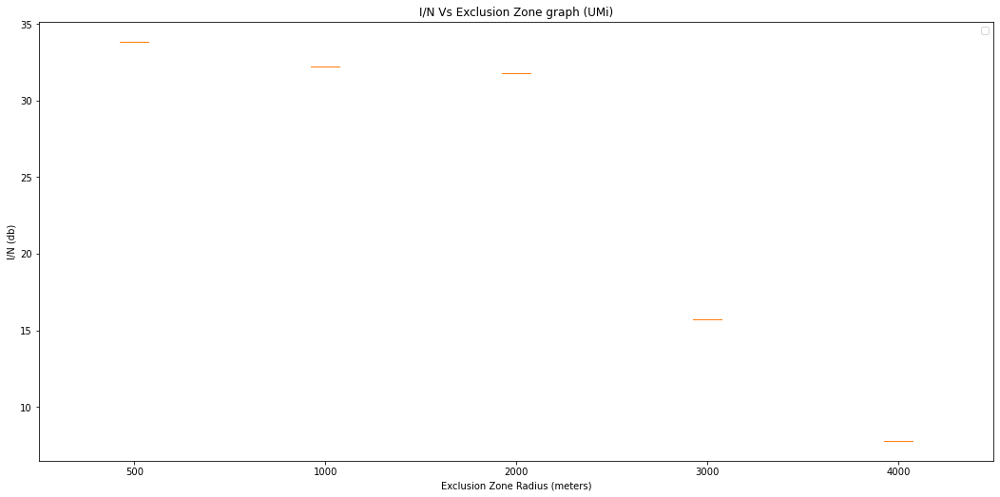

In [31]:
# EXCLUSION ZONE

# Creating dataset
# distance, interface_Noise = pairs_noAverage['UMi']
distance, interface_Noise = pairs['UMi']
 
# print(box_dict_UMi)
 
fig, ax = plt.subplots()

# Creating plot
for i, exclusion_zone in enumerate(exclusion_zones):
    # key is exclusion zone
#     ax.boxplot(interface_Noise[exclusion_zone],
     ax.boxplot([interface_Noise[exclusion_zone]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white'))

# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in exclusion_zones])
 
ax.set_title('I/N Vs Exclusion Zone graph (UMi)')
ax.set_xlabel('Exclusion Zone Radius (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUmiexclusionsum5km.pdf', dpi=100)
plt.show()

In [32]:
len(pairs_noAverage['UMi'][1][2000])/10

25.0

2022-11-06 16:00:19,708 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


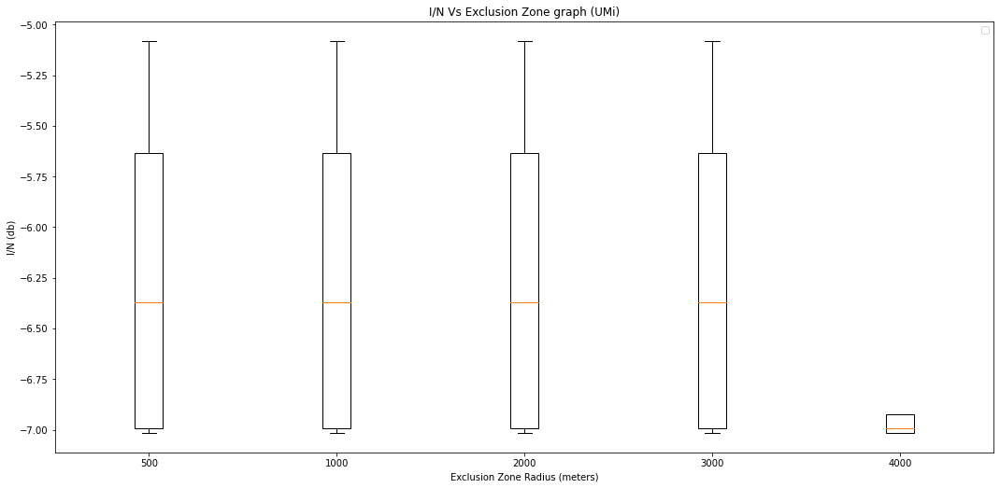

In [40]:
# EXCLUSION ZONE (-15db BS)

# Creating dataset
distance, interface_Noise = pairs_noAverage['UMi']
# distance, interface_Noise = pairs['UMi']
 
# print(box_dict_UMi)
 
fig, ax = plt.subplots()

# Creating plot
for i, exclusion_zone in enumerate(exclusion_zones):
    # key is exclusion zone
#     ax.boxplot(interface_Noise[exclusion_zone],
     ax.boxplot( [x for x in  interface_Noise[exclusion_zone] if x < -5], #(lowest could be -7db)
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white'))

# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in exclusion_zones])
 
ax.set_title('I/N Vs Exclusion Zone graph (UMi)')
ax.set_xlabel('Exclusion Zone Radius (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('-15db_aggregate_omni_graphUmiexclusion5km.pdf', dpi=100)
plt.show()

In [34]:
# # Creating dataset
# box_dict_UMi = dict{2: I_N_UMi for 2000, 5: I_N_UMi for 5000, 10: I_N_UMi for 10000}
# distance, interface_Noise = pairs_noAverage['UMi']
# for i in range(len(interface_Noise)):
#     if not line_of_sight[i]:
#         continue   
#     if distance[i] not in box_dict_UMi:
#         box_dict_UMi[distance[i]] = []
#     box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# # print(box_dict_UMi)

# fig, ax= plt.subplots()
 
# # Creating plot
# keys = sorted([key for key in box_dict_UMi])
# for i, key in enumerate(keys):
#     # key is distance
#     # print(key)
#     # print(box_dict_UMi[key])
#     line_of_sight1 = box_dict_UMi[key][0][1]
#     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
#                patch_artist=True,
#                positions=[i],
#                boxprops=dict(facecolor='white', color='blue' if line_of_sight1  else 'red'))
    
# #     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
# #                patch_artist=True,
# #                positions=[i],
# #                boxprops=dict(facecolor='white', color='red' if not line_of_sight1))
                
# # keys = sorted([key for key in box_dict_UMi])
# # ax.boxplot([box_dict_UMi[key] for key in keys])
# ax.set_xticklabels([int(i) for i in keys])

# ax.set_title('I/N Vs Distance graph (UMi LOS)')
# ax.set_xlabel('Distnace of Each BS from FSS (meters)')
# ax.set_ylabel('I/N (db)')
# ax.legend()
 
# # show plot
# # plt.show()
# fig.set_size_inches(18, 8.5)
# # fig.savefig('graphUmiomniwithlog10.pdf', dpi=100)
# plt.show()





In [35]:
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if line_of_sight[i]:
        continue
        
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMi[key][0][1]
#     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
#                patch_artist=True,
#                positions=[i],
#                boxprops=dict(facecolor='white', color='blue' if line_of_sight1))
    
    ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='red' if not line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMi NLOS)')
ax.set_xlabel('Distnace of Each BS from FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUmiomniwithlog10.pdf', dpi=100)
plt.show()
    

KeyError: 2

In [ ]:
# Creating dataset
box_dict_UMa = dict()
distance, interface_Noise = pairs_noAverage['UMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMa:
        box_dict_UMa[distance[i]] = []
    box_dict_UMa[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMa])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMa[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_UMa[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMa)')
ax.set_xlabel('Distnace of Each BS to FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUMa.pdf', dpi=100)
plt.show()

In [ ]:
# Creating dataset
box_dict_RMa = dict()
distance, interface_Noise = pairs_noAverage['RMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_RMa:
        box_dict_RMa[distance[i]] = []
    box_dict_RMa[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_RMa])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_RMa[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_RMa[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (RMa)')
ax.set_xlabel('Distnace of Each BS to FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphRma.pdf', dpi=100)
plt.show()